#### Team Name: sso9282_sk11297_zy2891  
#### Team Members: Simar Oberoi (sso9282), Soohan Kim (sk11297), Zehao Yang (zy2891) 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from tqdm import tqdm
import zipfile

# 1

In [2]:
data_path = '../data/facteus_10k_user_panel.zip'
zipped = zipfile.ZipFile(data_path, 'r')
df = pd.read_csv(zipped.open('facteus_10k_user_panel.csv'))
df.head(10)


,account,date,merchant,merchant_string_example,merchant_ticker,merchant_exchange,transactions,spend,spend_min,spend_max
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPUGLV,AMZN,NASDAQ,2,4.72,1.88,2.84
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,DUNKIN DONUTS,DUNKIN #308696 Q35 IRVINGTON NJUS0EBSE,DNKN,NASDAQ,1,7.33,7.33,7.33
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,EXXON MOBIL,EXXONMOBIL 99243909 NEWARK NJUS1JJWD,XOM,NYSE,1,10.02,10.02,10.02
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,PNC BANK,PNC BANK MAPYJCUN,PNC,NYSE,3,212.44,29.74,102.36
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSOA5ML,AMZN,NASDAQ,3,44.04,10.17,20.94
5,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,IHOP,IHOP #2055 IRVINGTON NJUSZFZBP,DIN,NYSE,1,83.83,83.83,83.83
6,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,PNC BANK,PNC BANK MAPV1IIP,PNC,NYSE,6,811.70,19.66,406.45
7,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,SUBWAY,SUBWAY 00561274 HILLSIDE NJUSXZHFG,NaN,NaN,1,13.75,13.75,13.75
8,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,WAWA,WAWA 8350 00083501 MAPLEWOOD NJUSBHZJA,NaN,NaN,1,14.96,14.96,14.96
9,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-03-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPCVGF,AMZN,NASDAQ,1,21.05,21.05,21.05


## 1. Regular Expressions
### a. Isolate / find all variations of merchant strings belonging to merchant  MCDONALDS, AMAZON, APPLE

In [3]:
regex_merchants = []

for row in tqdm(df['merchant_string_example']):
    
    if re.search(r'\bKINDLE\b | \bAM(A)?Z(?:ONPRIME|ON|N)\b | \bPRIME\b', str(row)):
        regex_merchants.append('AMAZON')
    elif re.search(r'(AP(P)?L(E)?) | (ITUNES)', str(row)):
        regex_merchants.append('APPLE')
    elif re.search(r'(MCDONALD)', str(row)):
        regex_merchants.append('MCDONALDS')
    else:
        regex_merchants.append(None)
        
df['regex_merchants'] = regex_merchants

for i in tqdm(range(len(df))): 
    print(df.loc[i, ['merchant', 'merchant_string_example', 'regex_merchants']])
    
    if i > 10000:
        break

  0%|          | 322/4242945 [00:00<43:51, 1612.27it/s]

merchant                                                          AMAZON
merchant_string_example    AMAZON MKTPLACE PMTS   AMZN.COM/BILLWAUSPUGLV
regex_merchants                                                     None
Name: 0, dtype: object
merchant                                                   DUNKIN DONUTS
merchant_string_example    DUNKIN #308696 Q35     IRVINGTON    NJUS0EBSE
regex_merchants                                                     None
Name: 1, dtype: object
merchant                                                     EXXON MOBIL
merchant_string_example    EXXONMOBIL    99243909 NEWARK       NJUS1JJWD
regex_merchants                                                     None
Name: 2, dtype: object
merchant                                         PNC BANK
merchant_string_example    PNC BANK              MAPYJCUN
regex_merchants                                      None
Name: 3, dtype: object
merchant                                                          AMAZON
merc

  0%|          | 634/4242945 [00:00<47:52, 1476.77it/s]

merchant                                                            WAWA
merchant_string_example    WAWA STORE 51600051607 ORLANDO      FLUSPXJOL
regex_merchants                                                     None
Name: 396, dtype: object
merchant                                                        7-ELEVEN
merchant_string_example    7-ELEVEN 34768         ORLANDO      FLUS5IBS0
regex_merchants                                                     None
Name: 397, dtype: object
merchant                                                   BOSTON MARKET
merchant_string_example    BOSTON MARKET 0348     ORLANDO      FLUSWRDGE
regex_merchants                                                     None
Name: 398, dtype: object
merchant                                               JERSEY MIKES SUBS
merchant_string_example    JERSEY MIKES 13059     APOPKA       FLUSBLDEM
regex_merchants                                                     None
Name: 399, dtype: object
merchant                

  0%|          | 785/4242945 [00:00<47:35, 1485.76it/s]

merchant                                                          BP GAS
merchant_string_example    BP#89329151245 WLMNGTN WILMINGTON   OHUSOG5Z3
regex_merchants                                                     None
Name: 714, dtype: object
merchant                                                     BURGER KING
merchant_string_example    BURGER KING #6644      WILMINGTON     OHEWVYL
regex_merchants                                                     None
Name: 715, dtype: object
merchant                                                     DAIRY QUEEN
merchant_string_example    DAIRY QUEEN 15504      WILMINGTON   OHUSDL1W2
regex_merchants                                                     None
Name: 716, dtype: object
merchant                                                     GREAT CLIPS
merchant_string_example    2268 GREAT CLIPS AT SAUHILLSBORO    OHUSZ5DI5
regex_merchants                                                     None
Name: 717, dtype: object
merchant                

  0%|          | 1062/4242945 [00:00<1:04:27, 1096.93it/s]

merchant                                               TIME WARNER CABLE
merchant_string_example    TWC*TIMEWARNERCABLE    513-469-1112 OHUSX1PRD
regex_merchants                                                     None
Name: 921, dtype: object
merchant                                                         WALMART
merchant_string_example    WM SUPERC WAL-MART SUP WILMINGTON     OHNWDRL
regex_merchants                                                     None
Name: 922, dtype: object
merchant                                                          AMAZON
merchant_string_example    AMZN MKTP US*M692K8ZU2 AMZN.COM/BILLWAUSCQV2N
regex_merchants                                                     None
Name: 923, dtype: object
merchant                                                           ARBYS
merchant_string_example    ARBYS 6303             HILLSBORO    OHUSBUJZC
regex_merchants                                                     None
Name: 924, dtype: object
merchant                

  0%|          | 1356/4242945 [00:01<55:13, 1279.93it/s]  

merchant                                                          AMAZON
merchant_string_example    PRIME VIDEO*UQ96E93J3  888-802-3080 WAUSMQR5L
regex_merchants                                                     None
Name: 1131, dtype: object
merchant                                                           ARBYS
merchant_string_example    ARBY'S #5661           WILMINGTON   OHUSOV22P
regex_merchants                                                     None
Name: 1132, dtype: object
merchant                                                          BP GAS
merchant_string_example    BP#89329151245 WLMNGTN WILMINGTON   OHUSZEWQK
regex_merchants                                                     None
Name: 1133, dtype: object
merchant                                              BUFFALO WILD WINGS
merchant_string_example    BUFFALO WILD WINGS     WILMINGTON   OHUSCBQK5
regex_merchants                                                     None
Name: 1134, dtype: object
merchant            

  0%|          | 1695/4242945 [00:01<47:43, 1481.06it/s]

merchant                                                    WAFFLE HOUSE
merchant_string_example    WAFFLE HOUSE 284       FAIRBURN     GAUSARSLE
regex_merchants                                                     None
Name: 1474, dtype: object
merchant                                                           APPLE
merchant_string_example    APPLE.COM/BILL         866-712-7753 CAUSJGERT
regex_merchants                                                     None
Name: 1475, dtype: object
merchant                             BOJANGLES FAMOUS CHICKEN N BISCUITS
merchant_string_example    BOJANGLES 1203         FAIRBURN     GAUSV1FNQ
regex_merchants                                                     None
Name: 1476, dtype: object
merchant                                                         CHEVRON
merchant_string_example    CHEVRON 0354014        FAIRBURN     GAUSTUXXR
regex_merchants                                                     None
Name: 1477, dtype: object
merchant            

  0%|          | 1998/4242945 [00:01<48:23, 1460.70it/s]

merchant                                                     ROSS STORES
merchant_string_example    ROSS STORES #1168      JACKSONVILLE   FLPQ1UR
regex_merchants                                                     None
Name: 1819, dtype: object
merchant                                                           SHELL
merchant_string_example    SHELL SERVICE S        JACKSONVILLE   FLYSB5W
regex_merchants                                                     None
Name: 1820, dtype: object
merchant                                                          TARGET
merchant_string_example    TARGET T- 9525 CROSSHI JACKSONVILLE   FLRUCMB
regex_merchants                                                     None
Name: 1821, dtype: object
merchant                                                       WALGREENS
merchant_string_example    WALGREENS STORE 8917 SAJACKSONVILLE FLUSJLMXD
regex_merchants                                                     None
Name: 1822, dtype: object
merchant            

  0%|          | 2299/4242945 [00:01<48:09, 1467.37it/s]

merchant                                                         WALMART
merchant_string_example    WM SUPERC WAL-MART SUP MEMPHIS        TNOI3UB
regex_merchants                                                     None
Name: 2120, dtype: object
merchant                                                          ZAXBYS
merchant_string_example    ZAXBY'S #51202         MEMPHIS      TNUSUZ4UB
regex_merchants                                                     None
Name: 2121, dtype: object
merchant                                                             ATT
merchant_string_example    AT&T*BILL PAYMENT      WWW.ATT.COM  TXUSNS05W
regex_merchants                                                     None
Name: 2122, dtype: object
merchant                                                          BP GAS
merchant_string_example    BP#8424921MACS STORE 36MEMPHIS      TNUSUEA3R
regex_merchants                                                     None
Name: 2123, dtype: object
merchant            

  0%|          | 2757/4242945 [00:01<46:57, 1504.97it/s]

merchant                                                            HULU
merchant_string_example    HLU*HULU 1254158556727-HULU.COM/BILLCAUSHJWTH
regex_merchants                                                     None
Name: 2447, dtype: object
merchant                                                            IHOP
merchant_string_example    IHOP #0479             COLUMBIA     SCUSNN0QE
regex_merchants                                                     None
Name: 2448, dtype: object
merchant                                             LOVES COUNTRY STORE
merchant_string_example    LOVES COUNTRY 00003269 ORANGEBURG   SCUSTS1QX
regex_merchants                                                     None
Name: 2449, dtype: object
merchant                                                         NETFLIX
merchant_string_example    NETFLIX.COM            NETFLIX.COM  CAUSRNK5P
regex_merchants                                                     None
Name: 2450, dtype: object
merchant            

  0%|          | 3098/4242945 [00:02<44:04, 1603.48it/s]

merchant                                                        CIRCLE K
merchant_string_example    CIRCLE K # 05689       SOLON        OHUSFJQVQ
regex_merchants                                                     None
Name: 2757, dtype: object
merchant                                                        COINMACH
merchant_string_example    OPS* COINMACH BEECHMONTBEACHWOOD    OHUSSSKB1
regex_merchants                                                     None
Name: 2758, dtype: object
merchant                                             GTL GLOBAL TEL LINK
merchant_string_example    GTL*INMATE PHONE SVC   877-650-4249 ALUSG5AEG
regex_merchants                                                     None
Name: 2759, dtype: object
merchant                                                       MCDONALDS
merchant_string_example    MCDONALD'S F12172      WOODMERE     OHUSARUUW
regex_merchants                                                MCDONALDS
Name: 2760, dtype: object
merchant            

  0%|          | 3259/4242945 [00:02<52:21, 1349.54it/s]

merchant                                                             CVS
merchant_string_example    CVS/PHARMACY #08932    TWINSBURG    OHUSWDRQO
regex_merchants                                                     None
Name: 3161, dtype: object
merchant                                                   DUNKIN DONUTS
merchant_string_example    DUNKIN #351269         GARFIELD HEIGOHUSQRMP4
regex_merchants                                                     None
Name: 3162, dtype: object
merchant                                                   FAMILY DOLLAR
merchant_string_example    FAMILY DOLLAR #        LAKEWOOD       OHUMHY4
regex_merchants                                                     None
Name: 3163, dtype: object
merchant                                                     FIRST WATCH
merchant_string_example    0138 FIRST WATCH       MACEDONIA    OHUSXAEC1
regex_merchants                                                     None
Name: 3164, dtype: object
merchant            

  0%|          | 3534/4242945 [00:02<1:03:03, 1120.56it/s]

merchant                                                CRICKET WIRELESS
merchant_string_example    CRICKET WIRELESS       855-246-2461 FLUSH2BT2
regex_merchants                                                     None
Name: 3371, dtype: object
merchant                                                         DOMINOS
merchant_string_example    DOMINO'S 6490          580-583-9210 OKUSSA4GO
regex_merchants                                                     None
Name: 3372, dtype: object
merchant                                                          GOOGLE
merchant_string_example    GOOGLE *GOOGLE PLAY    G.CO/HELPPAY#CAUSZJRHP
regex_merchants                                                     None
Name: 3373, dtype: object
merchant                                                             H&M
merchant_string_example    H&M ONLINE #7700       855-466-7467 ILUSUNYIN
regex_merchants                                                     None
Name: 3374, dtype: object
merchant            

  0%|          | 3860/4242945 [00:02<53:13, 1327.36it/s]  

merchant                                                         NETFLIX
merchant_string_example    NETFLIX.COM            NETFLIX.COM  CAUSQBZYP
regex_merchants                                                     None
Name: 3636, dtype: object
merchant                           ON THE BORDER MEXICAN GRILL & CANTINA
merchant_string_example    ON THE BORDER          TULSA        OKUSBAOZ2
regex_merchants                                                     None
Name: 3637, dtype: object
merchant                                                    OREILLY AUTO
merchant_string_example    OREILLY AUTO #4601     TULSA        OKUS15R2N
regex_merchants                                                     None
Name: 3638, dtype: object
merchant                                                         PATREON
merchant_string_example    CKO*PATREON* MEMBERSHIP833-9728766  CAUSOBHVH
regex_merchants                                                     None
Name: 3639, dtype: object
merchant            

  0%|          | 4198/4242945 [00:03<47:15, 1495.00it/s]

merchant                                                  DOLLAR GENERAL
merchant_string_example    DOLLAR-GE 11027 E 41ST TULSA          OKHYDZ3
regex_merchants                                                     None
Name: 3983, dtype: object
merchant                                                        ETSY.COM
merchant_string_example    ETSY.COM               718-8557955  NYUSET5E0
regex_merchants                                                     None
Name: 3984, dtype: object
merchant                                                             GNC
merchant_string_example    GNC #001695            TULSA        OKUSLWOCC
regex_merchants                                                     None
Name: 3985, dtype: object
merchant                                                            HULU
merchant_string_example    HLU*HULU 656015101924-UHULU.COM/BILLCAUSQJ0MT
regex_merchants                                                     None
Name: 3986, dtype: object
merchant            

  0%|          | 4520/4242945 [00:03<45:39, 1547.03it/s]

merchant                                                          SUBWAY
merchant_string_example    SUBWAY        00179523 FREDERICKSBRGVAUSM3YCI
regex_merchants                                                     None
Name: 4334, dtype: object
merchant                                                       TACO BELL
merchant_string_example    TACO BELL 2326         ASHLAND      VAUSCJMVW
regex_merchants                                                     None
Name: 4335, dtype: object
merchant                                                         WALMART
merchant_string_example    WAL-MART SUPER CENTER  FREDRICKSBURG  VAAX52R
regex_merchants                                                     None
Name: 4336, dtype: object
merchant                                                            WAWA
merchant_string_example    WAWA 8652              ASHLAND      VAUSWQ2LV
regex_merchants                                                     None
Name: 4337, dtype: object
merchant            

  0%|          | 4852/4242945 [00:03<44:11, 1598.24it/s]

merchant                                                         VERIZON
merchant_string_example    VZWRLSS*IVR VN         800-922-0204 FLUSISQKH
regex_merchants                                                     None
Name: 4674, dtype: object
merchant                                                       WALGREENS
merchant_string_example    WALGREENS STORE 3110 W CHICAGO      ILUSPKJTH
regex_merchants                                                     None
Name: 4675, dtype: object
merchant                                                         WALMART
merchant_string_example    WM SUPERC WAL-MART SUP CHICAGO        ILJ1MJA
regex_merchants                                                     None
Name: 4676, dtype: object
merchant                                                          WENDYS
merchant_string_example    WENDY'S #11846         CHICAGO      ILUSGGK4F
regex_merchants                                                     None
Name: 4677, dtype: object
merchant            

  0%|          | 5380/4242945 [00:03<41:24, 1705.30it/s]

merchant                                                       MCDONALDS
merchant_string_example    DOORDASH*MCDONALDS     WWW.DOORDASH.CAUSOBSTA
regex_merchants                                                MCDONALDS
Name: 5030, dtype: object
merchant                                                        NINTENDO
merchant_string_example    NINTENDO    *AMERICAUS 800-255-3700 WAUSXKKZS
regex_merchants                                                     None
Name: 5031, dtype: object
merchant                                  PLAYSTATION SONY ENTERTAINMENT
merchant_string_example    SIE*PLAYSTATIONNETWORK 877-971-7669 CAUSH1NJP
regex_merchants                                                     None
Name: 5032, dtype: object
merchant                                                          TARGET
merchant_string_example    TARGET        00014373 CHICAGO      ILUSKCZ0L
regex_merchants                                                     None
Name: 5033, dtype: object
merchant            

  0%|          | 5729/4242945 [00:03<41:36, 1697.11it/s]

merchant                                           OLLIES BARGAIN OUTLET
merchant_string_example    OLLIES BARGAIN OUTLET 3ROANOKE      VAUSHSSB4
regex_merchants                                                     None
Name: 5512, dtype: object
merchant                                                         PATREON
merchant_string_example    PATREON* MEMBERSHIP    HTTPSWWW.PATRCAUS3ECEP
regex_merchants                                                     None
Name: 5513, dtype: object
merchant                                                       STARBUCKS
merchant_string_example    STARBUCKS STORE 11152  ROANOKE      VAUSQXJPA
regex_merchants                                                     None
Name: 5514, dtype: object
merchant                                                         WALMART
merchant_string_example    WALMART.COM 8009666546 800-966-6546 ARUSCWPKA
regex_merchants                                                     None
Name: 5515, dtype: object
merchant            

  0%|          | 6078/4242945 [00:04<49:42, 1420.65it/s]

merchant                                                     GODADDY.COM
merchant_string_example    DNH*GODADDY.COM        480-5058855  AZUSHQZY3
regex_merchants                                                     None
Name: 5862, dtype: object
merchant                                                LES SCHWAB TIRES
merchant_string_example    LES SCHWAB TIRES 4110 WKENNEWICK    WAUS4G1ZS
regex_merchants                                                     None
Name: 5863, dtype: object
merchant                                                       MCDONALDS
merchant_string_example    MCDONALD'S F5223       KENNEWICK    WAUSLYVGP
regex_merchants                                                MCDONALDS
Name: 5864, dtype: object
merchant                                                       STARBUCKS
merchant_string_example    STARBUCKS STORE 09786  PASCO        WAUS0ZINL
regex_merchants                                                     None
Name: 5865, dtype: object
merchant            

  0%|          | 6423/4242945 [00:04<45:26, 1553.85it/s]

merchant                                                           APPLE
merchant_string_example    APL*ITUNES.COM/BILL    866-712-7753 CAUSYNLQ1
regex_merchants                                                     None
Name: 6177, dtype: object
merchant                                                        BIRCHBOX
merchant_string_example    BBX*BIRCHBOX INC       877-4877272  NYUSIGGU3
regex_merchants                                                     None
Name: 6178, dtype: object
merchant                                                        CIRCLE K
merchant_string_example    CIRCLE K 270603        PASCO          WAR32FE
regex_merchants                                                     None
Name: 6179, dtype: object
merchant                                                            IPSY
merchant_string_example    IPSY   *GLAM BAG       HELP.IPSY.COMCAUSH1SMK
regex_merchants                                                     None
Name: 6180, dtype: object
merchant            

  0%|          | 6760/4242945 [00:04<43:39, 1616.90it/s]

merchant                                                            USPS
merchant_string_example    USPS.COM MOVER'S GUIDE 800-238-3150 TNUSKW2LF
regex_merchants                                                     None
Name: 6550, dtype: object
merchant                                                             ATT
merchant_string_example    AT&T   *PAYMENT        800-288-2020 TXUSVNPI5
regex_merchants                                                     None
Name: 6551, dtype: object
merchant                                                    BOOST MOBILE
merchant_string_example    BOOST MOBILE           888-266-7848 KSUSFISP4
regex_merchants                                                     None
Name: 6552, dtype: object
merchant                                                     BURGER KING
merchant_string_example    BURGER KING #11934     MEMPHIS      TNUSIHXEG
regex_merchants                                                     None
Name: 6553, dtype: object
merchant            

  0%|          | 7111/4242945 [00:04<42:00, 1680.51it/s]

merchant                                          TROPICAL SMOOTHIE CAFE
merchant_string_example    LEVELUP*TROPICALSMOOTH 855-466-5585 MAUSM0MZU
regex_merchants                                                     None
Name: 6910, dtype: object
merchant                                                         WALMART
merchant_string_example    WM SUPERC WAL-MART SUP TOLEDO         OH5T22T
regex_merchants                                                     None
Name: 6911, dtype: object
merchant                                                          WENDYS
merchant_string_example    WENDY'S 0173           MAUMEE       OHUS4QEVM
regex_merchants                                                     None
Name: 6912, dtype: object
merchant                                                        WINGSTOP
merchant_string_example    WINGSTOP               MAUMEE       OHUSMRVF4
regex_merchants                                                     None
Name: 6913, dtype: object
merchant            

  0%|          | 7456/4242945 [00:04<41:33, 1698.91it/s]

merchant                                                          CHILIS
merchant_string_example    CHILI'S TOCO HILLS     ATLANTA      GAUST5WDA
regex_merchants                                                     None
Name: 7283, dtype: object
merchant                                                          HILTON
merchant_string_example    HILTON HOTELS          404-6592000  GAUS4KNAO
regex_merchants                                                     None
Name: 7284, dtype: object
merchant                                                            LYFT
merchant_string_example    LYFT   *RIDE WED 9AM   LYFT.COM     CAUSTOTUL
regex_merchants                                                     None
Name: 7285, dtype: object
merchant                                                        QUIKTRIP
merchant_string_example    QUIKTRIP#759R          STONE MOUNTAIGAUSOJIDR
regex_merchants                                                     None
Name: 7286, dtype: object
merchant            

  0%|          | 7798/4242945 [00:05<50:36, 1394.74it/s]

merchant                                                          BP GAS
merchant_string_example    BP GLENDALE            GLENDALE       NYL0KR4
regex_merchants                                                     None
Name: 7627, dtype: object
merchant                                                        CHIPOTLE
merchant_string_example    CHIPOTLE 1987          FOREST HILLS NYUSWR45E
regex_merchants                                                     None
Name: 7628, dtype: object
merchant                                                           CITGO
merchant_string_example    CITGO LOU CAL SERVICE CBAYSIDE      NYUS5KOKH
regex_merchants                                                     None
Name: 7629, dtype: object
merchant                                                     HUDSON NEWS
merchant_string_example    HUDSONNEWS  ST1177     JAMAICA      NYUSQDK2R
regex_merchants                                                     None
Name: 7630, dtype: object
merchant            

  0%|          | 8112/4242945 [00:05<50:09, 1407.09it/s]

merchant                                                         GROUPON
merchant_string_example    GROUPON INC            GROUPON.COM  ILUSS32SI
regex_merchants                                                     None
Name: 7886, dtype: object
merchant                                                            LYFT
merchant_string_example    LYFT   *RIDE TUE 11AM  LYFT.COM     CAUSMJWNW
regex_merchants                                                     None
Name: 7887, dtype: object
merchant                                         PNC BANK
merchant_string_example    PNC BANK              NEPBY5BW
regex_merchants                                      None
Name: 7888, dtype: object
merchant                                                        SPEEDWAY
merchant_string_example    SPEEDWAY 07828 129 N COSOUTH OZONE PNYUSS3HVR
regex_merchants                                                     None
Name: 7889, dtype: object
merchant                                                         

  0%|          | 8395/4242945 [00:05<53:31, 1318.63it/s]

merchant                                                 CHURCHS CHICKEN
merchant_string_example    CHURCH'S #4293F        MONCKS CORNERSCUSPFMEL
regex_merchants                                                     None
Name: 8169, dtype: object
merchant                                                  DOLLAR GENERAL
merchant_string_example    DOLLAR GE SC-6/45      CROSS          SC4W0QP
regex_merchants                                                     None
Name: 8170, dtype: object
merchant                                                   FAMILY DOLLAR
merchant_string_example    FAMILY DOLLAR #        ST STEPHEN     SCRAGHK
regex_merchants                                                     None
Name: 8171, dtype: object
merchant                                                             IGA
merchant_string_example    ST STEPHENS IGA #5     SAINT STEPHENSCUSTDHBW
regex_merchants                                                     None
Name: 8172, dtype: object
merchant            

  0%|          | 8685/4242945 [00:05<51:01, 1382.96it/s]

merchant                                                           CITGO
merchant_string_example    CITGO JAY MATAJI       SANTEE       SCUSMI3M5
regex_merchants                                                     None
Name: 8467, dtype: object
merchant                                                  DOLLAR GENERAL
merchant_string_example    DOLLAR GE DG 128721569 CROSS          SCO3JGJ
regex_merchants                                                     None
Name: 8468, dtype: object
merchant                                                     DOLLAR TREE
merchant_string_example    DOLLAR TR 441 DRIVE IN MONCKS CORNER  SCX4R0D
regex_merchants                                                     None
Name: 8469, dtype: object
merchant                                                   FAMILY DOLLAR
merchant_string_example    FAMILY DOLLAR #        CROSS          SC53HWU
regex_merchants                                                     None
Name: 8470, dtype: object
merchant            

  0%|          | 8826/4242945 [00:06<53:12, 1326.32it/s]

merchant                                                           KOHLS
merchant_string_example    KOHLS 1388 350 SHOWERS MOUNTAIN VIEWCAUSLVYLO
regex_merchants                                                     None
Name: 8777, dtype: object
merchant                                                  LITTLE CAESARS
merchant_string_example    LITTLE CAESARS 1374 000MOUNTAIN VIEWCAUS0QTG1
regex_merchants                                                     None
Name: 8778, dtype: object
merchant                                                       MCDONALDS
merchant_string_example    MCDONALDS  F3094       PALO ALTO    CAUSWUXXQ
regex_merchants                                                MCDONALDS
Name: 8779, dtype: object
merchant                                                    OREILLY AUTO
merchant_string_example    O'REILLY AUTO PARTS 346NEWARK       CAUSIBAPV
regex_merchants                                                     None
Name: 8780, dtype: object
merchant            

  0%|          | 9077/4242945 [00:06<1:05:08, 1083.33it/s]

merchant                                                   RAINBOW SHOPS
merchant_string_example    RAINBOW #1492 1524 POINGREENVILLE   SCUSPWYIY
regex_merchants                                                     None
Name: 8940, dtype: object
merchant                               RED ROBIN GOURMET BURGERS & BREWS
merchant_string_example    RED ROBIN NO 665       GREENVILLE   SCUSTEC1M
regex_merchants                                                     None
Name: 8941, dtype: object
merchant                                                     ROSS STORES
merchant_string_example    ROSS STORES #758       SIMPSONVILLE SCUSHKMM4
regex_merchants                                                     None
Name: 8942, dtype: object
merchant                                                           RUE21
merchant_string_example    RUE21 1526 POINSETT HWYGREENVILLE   SCUSK5YRB
regex_merchants                                                     None
Name: 8943, dtype: object
merchant            

  0%|          | 9450/4242945 [00:06<59:02, 1195.21it/s]  

merchant                   SQUARE
merchant_string_example       NaN
regex_merchants              None
Name: 9192, dtype: object
merchant                                          STRAIGHT TALK WIRELESS
merchant_string_example    STRAIGHTTALK*SERVICES  877-430-2355 FLUST4TKC
regex_merchants                                                     None
Name: 9193, dtype: object
merchant                                             USA CANTEEN VENDING
merchant_string_example    3-AVE C MKT 8889790062 TROY         MIUSDY4N3
regex_merchants                                                     None
Name: 9194, dtype: object
merchant                                                       WALGREENS
merchant_string_example    WALGREENS STORE 104 W BMAULDIN      SCUSMURW4
regex_merchants                                                     None
Name: 9195, dtype: object
merchant                                                         WALMART
merchant_string_example    WAL-MART SUPER CENTER  SIMPSONVILLE  

  0%|          | 9722/4242945 [00:06<55:34, 1269.62it/s]

merchant                                     FIVE GUYS BURGERS AND FRIES
merchant_string_example    FIVE GUYS SC 0319 ECOMM864-288-3950 SCUSUWFS0
regex_merchants                                                     None
Name: 9530, dtype: object
merchant                                                         HARDEES
merchant_string_example    HARDEES 1501752        SIMPSONVILLE SCUSWNAXX
regex_merchants                                                     None
Name: 9531, dtype: object
merchant                                                            HULU
merchant_string_example    HLU*HULU 409459209171-UHULU.COM/BILLCAUS4S1TW
regex_merchants                                                     None
Name: 9532, dtype: object
merchant                                                            IPSY
merchant_string_example    IPSY GLAM BAG          HELP.IPSY.COMCAUSY451G
regex_merchants                                                     None
Name: 9533, dtype: object
merchant            

  0%|          | 9851/4242945 [00:06<57:01, 1237.33it/s]

merchant                                                  DOLLAR GENERAL
merchant_string_example    DOLLAR-GENERAL #1471   ANDERSON     INUSQZFP2
regex_merchants                                                     None
Name: 9805, dtype: object
merchant                                                           LOWES
merchant_string_example    LOWES #01031*          ANDERSON     INUSXQM3D
regex_merchants                                                     None
Name: 9806, dtype: object
merchant                                              MARATHON PETROLEUM
merchant_string_example    MARATHON PETRO138149   ANDERSON     INUSE2TH4
regex_merchants                                                     None
Name: 9807, dtype: object
merchant                                                         MENARDS
merchant_string_example    MNRD-ANDERSON 2245 EASTANDERSON     INUSQBUXF
regex_merchants                                                     None
Name: 9808, dtype: object
merchant            

  0%|          | 10001/4242945 [00:07<50:27, 1398.17it/s]

merchant                                                          KROGER
merchant_string_example    KROGER #8 3050 MERIDAN ANDERSON       INMQZZV
regex_merchants                                                     None
Name: 9959, dtype: object
merchant                                              MARATHON PETROLEUM
merchant_string_example    MARATHON PETRO179242   ANDERSON     INUSZBWPO
regex_merchants                                                     None
Name: 9960, dtype: object
merchant                                                       MCDONALDS
merchant_string_example    MCDONALD'S F3247       ANDERSON     INUSWZHH2
regex_merchants                                                MCDONALDS
Name: 9961, dtype: object
merchant                                                          MEIJER
merchant_string_example    MEIJER 136             ANDERSON     INUSHQUDO
regex_merchants                                                     None
Name: 9962, dtype: object
merchant            

### b. Create regexp to isolate the City where the transaction occurred

In [4]:
df_filtered = df[df['regex_merchants'].isin(['AMAZON', 'APPLE', 'MCDONALDS'])]
# Iterate through all merchant strings associated with Amazon, Apple, Mcdonald's
for row in df_filtered['merchant_string_example'].dropna():
    
    # Only try extracting cities for Mcdonald's as observations in the above cell tell us it is hard to discern cities for others
    if str(row).startswith('M'):
        print(row)
        
        # Select alphabet-words up until 'US'
        match = re.search(r"\b([A-Z]+(?:\s+[A-Z]+)*)US", row)
        
        if match:
            city = match.group(0)[:-4] # drop the state (2 letters) and 'US'
        
            if city.startswith('OF'): # exception handling for cases where 'OF (2-letter STATE)' appears before city name
                city = city[6:]
                
            print(city)
            print('\n')

MCDONALD'S F7991       IRVINGTON    NJUSULB4I
IRVINGTON    


MCDONALD'S F7991       IRVINGTON    NJUSVJ31Q
IRVINGTON    


MCDONALD'S F1928       NEWARK       NJUSSCO13
NEWARK       


MCDONALD'S F1166       NORWICH      CTUSYIUH3
NORWICH      


MCDONALD'S M2316       ORLANDO      FLUSJO21U
ORLANDO      


MCDONALD'S F10751      ORLANDO      FLUS3P250
ORLANDO      


MCDONALD'S F19918      WINTER PARK  FLUSGI4FP
WINTER PARK  


MCDONALDS  F6296       ORLANDO      FLUST0YGY
ORLANDO      


MCDONALD'S M2316       ORLANDO      FLUSEXRGY
ORLANDO      


MCDONALDS  F6296       ORLANDO      FLUSOQGTN
ORLANDO      


MCDONALDS M7574        ORLANDO      FLUSYJ4HC
ORLANDO      


MCDONALD'S M4199 OF FL SANFORD      FLUSZVQYG
SANFORD      


MCDONALD'S M7516       KISSIMMEE    FLUSRSUNM
KISSIMMEE    


MCDONALD'S F7004       ST AUGUSTINE FLUSE5EBA
ST AUGUSTINE 


MCDONALD'S M2316       ORLANDO      FLUSNHLKP
ORLANDO      


MCDONALD'S F33746      MINNEOLA     FLUSFOPTE
MINNEOLA     


MCDONALD

### c. Use any method to remove the transaction ID if it is present in the transaction.

In [5]:
# Locate transaction ID's by the following pattern '\*([A-Z]|[0-9]){9}'

for row in df_filtered['merchant_string_example'].dropna():
    
    print(row)
    
    match = re.search('\*([A-Z]|[0-9]){9}', row)
    
    if match:
        print(match.group(0))
        
    print('\n')

APL* ITUNES.COM/BILL   866-712-7753 CAUS15UUC


APL* ITUNES.COM/BILL   866-712-7753 CAUS5MVEO


APL* ITUNES.COM/BILL   866-712-7753 CAUSNBQII


MCDONALD'S F7991       IRVINGTON    NJUSULB4I


MCDONALD'S F7991       IRVINGTON    NJUSVJ31Q


MCDONALD'S F1928       NEWARK       NJUSSCO13


APL* ITUNES.COM/BILL   866-712-7753 CAUSUCIDJ


MCDONALD'S F1166       NORWICH      CTUSYIUH3


MCDONALD'S M2316       ORLANDO      FLUSJO21U


MCDONALD'S F10751      ORLANDO      FLUS3P250


MCDONALD'S F19918      WINTER PARK  FLUSGI4FP


MCDONALDS  F6296       ORLANDO      FLUST0YGY


MCDONALD'S M2316       ORLANDO      FLUSEXRGY


MCDONALDS  F6296       ORLANDO      FLUSOQGTN


MCDONALDS M7574        ORLANDO      FLUSYJ4HC


MCDONALD'S M4199 OF FL SANFORD      FLUSZVQYG


MCDONALD'S M7516       KISSIMMEE    FLUSRSUNM


MCDONALD'S F7004       ST AUGUSTINE FLUSE5EBA


MCDONALD'S M2316       ORLANDO      FLUSNHLKP


MCDONALD'S F33746      MINNEOLA     FLUSFOPTE


MCDONALD'S M2316       ORLANDO      FLUS

<>:7: SyntaxWarning: invalid escape sequence '\*'
<>:7: SyntaxWarning: invalid escape sequence '\*'
/var/folders/8_/bcfxzgvs0b7drc9_sjqz79km0000gn/T/ipykernel_45580/1438703262.py:7: SyntaxWarning: invalid escape sequence '\*'
  match = re.search('\*([A-Z]|[0-9]){9}', row)


KINDLE UNLIMITED       888-802-3080 WAUS3X5TL


APL* ITUNES.COM/BILL   866-712-7753 CAUSYNJYY


APL* ITUNES.COM/BILL   866-712-7753 CAUSM5ZG0


APPLE PAY - SENT MONEY 877-233-8552 CAUSVRBFJ


APL* ITUNES.COM/BILL   866-712-7753 CAUSS3OXJ


APL* ITUNES.COM/BILL   866-712-7753 CAUSYRHEX


APL* ITUNES.COM/BILL   866-712-7753 CAUSN5ITM


MCDONALD'S F4776       LOOUISVILLE  KYUS2J2AS


KINDLE UNLTD*MT8DJ0XD2 866-321-8851 WAUSPGHRQ
*MT8DJ0XD2


KINDLE UNLTD*M88215T30 866-321-8851 WAUSTD555
*M88215T30


KINDLE UNLTD*M23AL9VS2 866-321-8851 WAUSBPSLG
*M23AL9VS2


KINDLE UNLTD*MB7R46DJ1 866-321-8851 WAUSLS40O
*MB7R46DJ1


MCDONALD'S F15873      DETROIT      MIUS0OTGL


KINDLE UNLTD*MI4ZO3681 866-321-8851 WAUSCIT52
*MI4ZO3681


MCDONALD'S F33998      MOUNT JOY    PAUSGSI4Z


KINDLE UNLTD*B51OD9K83 866-321-8851 WAUSIDZYN
*B51OD9K83


DOORDASH*MCDONALDS     WWW.DOORDASH.CAUSV2Z0Z
*MCDONALDS


AMAZON PRIME*M429W21Q2 AMZN.COM/BILLWAUSLXKRC
*M429W21Q2


KINDLE UNLTD*282J79YZ0 866-321-8851 WAUSEKLJF
*2


#### i. Evaluate 200 randomly selected rows manually and construct a confusion matrix to evaluate your error rates.

In [6]:
sampled = df.sample(n=200, random_state=42)

# construct confusion matrix for merchant identification for AMAZON, APPLE, MCDONALDS
conf_mats = {'AMAZON':None, 'APPLE':None, 'MCDONALDS':None}
for merchant in conf_mats:
    tp = len(sampled[(sampled['merchant'] == merchant) & (sampled['regex_merchants'] == merchant)].reset_index(drop=True))
    fp = len(sampled[(sampled['merchant'] != merchant) & (sampled['regex_merchants'] == merchant)].reset_index(drop=True))
    tn = len(sampled[(sampled['merchant'] != merchant) & (sampled['regex_merchants'] != merchant)].reset_index(drop=True))
    fn = len(sampled[(sampled['merchant'] == merchant) & (sampled['regex_merchants'] != merchant)].reset_index(drop=True))
    conf_mats[merchant] = [[tp, fp], [fn, tn]]
    
conf_mats

{'AMAZON': [[1, 0], [4, 195]],
 'APPLE': [[0, 0], [4, 196]],
 'MCDONALDS': [[6, 0], [0, 194]]}

### ii. Devise a minimum number of regular expressions to achieve the above

In [7]:
regex_merchants = []
tids = []
cities = []

for row in tqdm(df['merchant_string_example']):
    
    # If merchant is AMAZON match Transaction ID
    tid_match = re.search(r'\b(?:KINDLE|PRIME|AM(A)?Z(?:ONPRIME|ON|N))\b.*?(\*[A-Z0-9]{9})', str(row))
    
    # If merchant is MCDONALDS match City
    city_match = re.search(r'(MCDONALD).*?(\b([A-Z]+(?:\s+[A-Z]+)*)US)', str(row))
    
    if tid_match:
        regex_merchants.append('AMAZON')
        tids.append(tid_match.group(2))  
        cities.append(None)
    
    # Same logic for locating merchant APPLE
    elif re.search(r'\b(?:AP(P)?L(E)?)\b|\bITUNES\b', str(row)):
        regex_merchants.append('APPLE')
        tids.append(None)
        cities.append(None)
    
    elif city_match:
        regex_merchants.append('MCDONALDS')
        city = city_match.group(2)[:-4] # drop the state (2 letters) and 'US'
        
        if city.startswith('OF'): # exception handling for cases where 'OF (2-letter STATE)' appears before city name
            city = city[6:]
            
        cities.append(city)  
        tids.append(None)
    
    # Default case if no matches found
    else:
        regex_merchants.append(None)
        tids.append(None)
        cities.append(None)

df['regex_merchants'] = regex_merchants
df['city'] = cities
df['tid'] = tids

df

100%|██████████| 4242945/4242945 [00:15<00:00, 270170.91it/s]


,account,date,merchant,merchant_string_example,merchant_ticker,merchant_exchange,transactions,spend,spend_min,spend_max,regex_merchants,city,tid
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPUGLV,AMZN,NASDAQ,2,4.72,1.88,2.84,None,None,None
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,DUNKIN DONUTS,DUNKIN #308696 Q35 IRVINGTON NJUS0EBSE,DNKN,NASDAQ,1,7.33,7.33,7.33,None,None,None
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,EXXON MOBIL,EXXONMOBIL 99243909 NEWARK NJUS1JJWD,XOM,NYSE,1,10.02,10.02,10.02,None,None,None
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,PNC BANK,PNC BANK MAPYJCUN,PNC,NYSE,3,212.44,29.74,102.36,None,None,None
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSOA5ML,AMZN,NASDAQ,3,44.04,10.17,20.94,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4242940,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01 00:00:00 UTC,7-ELEVEN,7ELEVEN-FCTI CHAZOZXT,3382,Tokyo Stock Exchange,8,206.00,2.13,60.89,None,None,None
4242941,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01 00:00:00 UTC,AMC THEATRES,AMC CAROLINA PAV #0681 CHARLOTTE NCUSR1YLQ,AMC,NYSE,1,13.70,13.70,13.70,None,None,None
4242942,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01 00:00:00 UTC,ARBYS,ARBYS #5989 CHARLOTTE CHARLOTTE NCUSRAMID,NaN,NaN,1,5.20,5.20,5.20,None,None,None
4242943,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01 00:00:00 UTC,BATH & BODY WORKS,BATH AND BODY WORKS 328PINEVILLE NCUS5CCGT,LB,NYSE,1,67.57,67.57,67.57,None,None,None


### iii. Try the regular expression on a sample of the rest of the data (or a uniform rand om sample of the data). Minimize false positives to 0 if possible

In [8]:
merchants = ['AMAZON', 'APPLE', 'MCDONALDS']
sampled = df[df['merchant'].isin(merchants) | df['regex_merchants'].isin(merchants)].sample(n=200, random_state=41).reset_index(drop=True)

for i in range(len(sampled)):
    print(sampled.loc[i, ['merchant_string_example', 'merchant', 'regex_merchants', 'city', 'tid']])
    print('\n')

merchant_string_example    MCDONALD'S F10682      DETROIT      MIUSTF5Q3
merchant                                                       MCDONALDS
regex_merchants                                                MCDONALDS
city                                                       DETROIT      
tid                                                                 None
Name: 0, dtype: object


merchant_string_example    AMAZONPRIME MEMBERSHIP AMZN.COM/PRMEWAUSMFMRW
merchant                                                          AMAZON
regex_merchants                                                     None
city                                                                None
tid                                                                 None
Name: 1, dtype: object


merchant_string_example    MCDONALDS  F540        MONTEBELLO   CAUSZWTMI
merchant                                                       MCDONALDS
regex_merchants                                                MCDONALDS
c

## 2. Text mining
### 1. Use sklearn

In [9]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

### 2. Filter in on the following merchants: WALMART, MCDONALDS, AMAZON, APPLE, SHELL,  WENDYS, TACO BELL, BURGER KING, DOLLAR GENERAL, ACE HARDWARE.

In [10]:
# Filter for merchants by merchant name
df_filtered = df[df['merchant'].isin([
    'WALMART', 'MCDONALDS', 'AMAZON', 'APPLE', 'SHELL', 'WENDYS', 'TACO BELL', 'BURGER KING', 'DOLLAR GENERAL', 'ACE HARDWARE'
])]

df_filtered.merchant.unique()

array(['AMAZON', 'APPLE', 'DOLLAR GENERAL', 'SHELL', 'MCDONALDS',
       'WALMART', 'TACO BELL', 'WENDYS', 'BURGER KING', 'ACE HARDWARE'],
      dtype=object)

### 3. Create a  1-3 gram vector space using no stemming from , no stop words and a word tokenizer with default settings, strip non alpha numeric and convert to all lowercase

### 4. Create a vector space matrix matrix from the above using countvectorizer and TfidfVectorizer. Steps c and d could possibly be done in 1-2 line of code. Try either or both for step f to maximize the accuracy.

In [11]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# Sample text data
documents = [
    "This is homework 1 of Alternative Data course!",
    "We include non-alphaneumeric characters here !*() &^$ to check",
    "We hope this makes the merchant name predictions successful."
]

# Initialize CountVectorizer 
count_vectorizer = CountVectorizer(
    ngram_range=(1, 3),               
    stop_words=None,                   
    token_pattern=r'\b\w+\b',          
    lowercase=True                     
)

# Fit and transform sample document data w/ CountVectorizer
count_matrix = count_vectorizer.fit_transform(documents)
count_feature_names = count_vectorizer.get_feature_names_out()
count_df = pd.DataFrame(count_matrix.toarray(), columns=count_feature_names)

# Initialize TfidfVectorizer 
tfidf_vectorizer = TfidfVectorizer(
    ngram_range=(1, 3),               
    stop_words=None,                   
    token_pattern=r'\b\w+\b',        
    lowercase=True                   
)

# Fit and transform sample document data w/ TfidfVectorizer
tfidf_matrix = tfidf_vectorizer.fit_transform(documents)
tfidf_feature_names = tfidf_vectorizer.get_feature_names_out()
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=tfidf_feature_names)

# Display the matrices
print("Count Vectorizer Matrix:")
print(count_df)

print("\nTF-IDF Vectorizer Matrix:")
print(tfidf_df)

Count Vectorizer Matrix:
   1  1 of  1 of alternative  alphaneumeric  alphaneumeric characters  \
0  1     1                 1              0                         0   
1  0     0                 0              1                         1   
2  0     0                 0              0                         0   

   alphaneumeric characters here  alternative  alternative data  \
0                              0            1                 1   
1                              1            0                 0   
2                              0            0                 0   

   alternative data course  characters  ...  this is homework  this makes  \
0                        1           0  ...                 1           0   
1                        0           1  ...                 0           0   
2                        0           0  ...                 0           1   

   this makes the  to  to check  we  we hope  we hope this  we include  \
0               0   0         

### 5. Remove ngrams which occur in less than ~3% of the strings. Try to minimize the number of columns while keeping the accuracy of the model in step f high.

In [12]:
documents = df_filtered['merchant_string_example'].dropna().tolist()
min_df_value = 0.03 # minimum frequency threshold

# Initialize CountVectorizer 
count_vectorizer = CountVectorizer(
    ngram_range=(1, 3),               
    stop_words=None,                   
    token_pattern=r'\b\w+\b',          
    lowercase=True,
    min_df=min_df_value
)

# Initialize TfidfVectorizer 
tfidf_vectorizer = TfidfVectorizer(
    ngram_range=(1, 3),               
    stop_words=None,                   
    token_pattern=r'\b\w+\b',        
    lowercase=True,
    min_df=min_df_value 
)

count_matrix = count_vectorizer.fit_transform(documents)
count_feature_names = count_vectorizer.get_feature_names_out()
count_df = pd.DataFrame(count_matrix.toarray(), columns=count_feature_names)

tfidf_matrix = tfidf_vectorizer.fit_transform(documents)
tfidf_feature_names = tfidf_vectorizer.get_feature_names_out()
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=tfidf_feature_names)

print("Count Vectorizer Matrix:")
print(count_df)

print("\nTF-IDF Vectorizer Matrix:")
print(tfidf_df)

Count Vectorizer Matrix:
        712  712 7753  7753  866  866 712  866 712 7753  amazon  amzn  \
0         0         0     0    0        0             0       1     1   
1         0         0     0    0        0             0       1     1   
2         0         0     0    0        0             0       1     1   
3         0         0     0    0        0             0       0     1   
4         0         0     0    0        0             0       0     1   
...     ...       ...   ...  ...      ...           ...     ...   ...   
937002    0         0     0    0        0             0       0     0   
937003    0         0     0    0        0             0       0     0   
937004    0         0     0    0        0             0       0     0   
937005    0         0     0    0        0             0       0     0   
937006    0         0     0    0        0             0       0     0   

        amzn com  amzn mktp  ...  wal  wal mart  wal mart sup  wal mart super  \
0              1 

### 6. Using the above matrix and a multi-label classification predictive model (recommend xgboost or logistic) to predict the merchant

### 7. Construct the model leaving some data out (10fold xval or a 20% random sample)

In [13]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.multioutput import MultiOutputClassifier
from sklearn.metrics import accuracy_score
import warnings

warnings.filterwarnings('ignore')

def build_n_evaluate(vectorized_df, model_name):
    # vectorized_df: either count or tfidf
    # model_name: 'xgb' or 'lr' for XG Boost or Logistic Regression
    
    if model_name == 'xgb':
        model = XGBClassifier(use_label_encoder=False, eval_metric='logloss')
    elif model_name == 'lr':
        model = LogisticRegression(max_iter=1000)
    else:
        print("Model should be one of 'xgb' or 'lr'")
        return

    # Sample n-gram feature matrix and target matrix
    X = vectorized_df
    y = pd.get_dummies(df_filtered[~df_filtered['merchant_string_example'].isna()].reset_index(drop=True)['merchant'])

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    classifier = MultiOutputClassifier(model)
    classifier.fit(X_train, y_train) # fit model
    y_pred = classifier.predict(X_test) # make predictions on test set
    acc = accuracy_score(y_test, y_pred) # measure OOS accuracy
    
    return acc, y_pred, y_test

# Initialize the base classifier (XGBoost) and perform train/test
xgb_count_acc, xgb_count_y_pred, count_y_test = build_n_evaluate(count_df, 'xgb')
xgb_tfidf_acc, xgb_tfidf_y_pred, tfidf_y_test = build_n_evaluate(tfidf_df, 'xgb')

# Initialize the base classifier (Logistic Regression) and perform train/test
lr_count_acc, lr_count_y_pred, _ = build_n_evaluate(count_df, 'lr')
lr_tfidf_acc, lr_tfidf_y_pred, _ = build_n_evaluate(tfidf_df, 'lr')

print(f"XG Boost + Count Model accuracy: {xgb_count_acc:.4f}")
print(f"XG Boost + TFIDF Model accuracy: {xgb_tfidf_acc:.4f}")
print(f"Logistic Regression + Count Model accuracy: {lr_count_acc:.4f}")
print(f"Logistic Regression + TFIDF Model accuracy: {lr_tfidf_acc:.4f}")

XG Boost + Count Model accuracy: 0.9846
XG Boost + TFIDF Model accuracy: 0.9847
Logistic Regression + Count Model accuracy: 0.9844
Logistic Regression + TFIDF Model accuracy: 0.9847


### 8. Evaluate your model on out-of-sample data and show out-of-sample error for each of the 10 merchants
### 9. Please show your work with comments in your Jupyter notebook

In [14]:
# Calculate accuracy per merchant
merchant_accuracies = {'XG Boost Count':{}, 'XG Boost TFIDF': {}, 'Logistic Regression Count': {}, 'Logistic Regression TFIDF':{}}

y = pd.get_dummies(df_filtered[~df_filtered['merchant_string_example'].isna()].reset_index(drop=True)['merchant'])

xgb_count_y_pred = pd.DataFrame(xgb_count_y_pred)
xgb_count_y_pred.columns = y.columns
xgb_tfidf_y_pred = pd.DataFrame(xgb_tfidf_y_pred)
xgb_tfidf_y_pred.columns = y.columns
lr_count_y_pred = pd.DataFrame(lr_count_y_pred)
lr_count_y_pred.columns = y.columns
lr_tfidf_y_pred = pd.DataFrame(lr_tfidf_y_pred)
lr_tfidf_y_pred.columns = y.columns

for merchant in y.columns:
    merchant_accuracies['XG Boost Count'][merchant] = accuracy_score(count_y_test[merchant], xgb_count_y_pred[merchant])
    merchant_accuracies['XG Boost TFIDF'][merchant] = accuracy_score(tfidf_y_test[merchant], xgb_tfidf_y_pred[merchant])
    merchant_accuracies['Logistic Regression Count'][merchant] = accuracy_score(count_y_test[merchant], lr_count_y_pred[merchant])
    merchant_accuracies['Logistic Regression TFIDF'][merchant] = accuracy_score(tfidf_y_test[merchant], lr_tfidf_y_pred[merchant])
    
pd.DataFrame.from_dict(merchant_accuracies, orient='columns')

,XG Boost Count,XG Boost TFIDF,Logistic Regression Count,Logistic Regression TFIDF
ACE HARDWARE,0.998314,0.998314,0.998202,0.998314
AMAZON,0.998298,0.998298,0.998298,0.998298
APPLE,0.999979,0.999989,0.999973,0.999989
BURGER KING,0.999701,0.999701,0.999691,0.999701
DOLLAR GENERAL,0.999973,0.999973,0.999973,0.999973
MCDONALDS,0.992561,0.992561,0.992561,0.992561
SHELL,1.000000,1.000000,0.999995,1.000000
TACO BELL,0.998922,0.998922,0.998821,0.998922
WALMART,0.995187,0.995187,0.995176,0.995176
WENDYS,0.999541,0.999541,0.999541,0.999541


## 3. Clustering and visualization

### 1. Reduce the matrix from section 2 to two (2) dimensions. Try Umap  first, if that doesn’t work try tSNE. You might need to normalize the matrix first for the below steps to work.

In [15]:
merchants = df_filtered[~df_filtered['merchant_string_example'].isna()].reset_index(drop=True)['merchant']
count_df['merchant'] = merchants
tfidf_df['merchant'] = merchants
count_df

,712,712 7753,7753,866,866 712,866 712 7753,amazon,amzn,amzn com,amzn mktp,...,wal mart,wal mart sup,wal mart super,wendy,wendy s,wendys,wm,wm superc,wm superc wal,merchant
0,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,AMAZON
1,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,AMAZON
2,0,0,0,0,0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,AMAZON
3,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,AMAZON
4,0,0,0,0,0,0,0,1,1,0,...,0,0,0,0,0,0,0,0,0,AMAZON
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
937002,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,MCDONALDS
937003,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,TACO BELL
937004,0,0,0,0,0,0,0,0,0,0,...,1,1,0,0,0,0,1,1,1,WALMART
937005,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,0,WENDYS


In [16]:
import umap

# Use only a subset of data for dimensionality reduction due to compute resource limitations
count_df_samp = count_df.sample(int(len(count_df)*0.1), random_state=42).reset_index(drop=True)
tfidf_df_samp = tfidf_df.sample(int(len(count_df)*0.1), random_state=42).reset_index(drop=True)

# Reduce count_df & tfidf_df to 2 dimensions using UMAP
umap_reducer = umap.UMAP(n_components=2, random_state=42)
count_umap_2d = umap_reducer.fit_transform(count_df_samp.drop(columns=['merchant']))
tfidf_umap_2d = umap_reducer.fit_transform(tfidf_df_samp.drop(columns=['merchant']))

# Convert results to DataFrames 
count_umap_df = pd.DataFrame(count_umap_2d, columns=['UMAP1', 'UMAP2'])
tfidf_umap_df = pd.DataFrame(tfidf_umap_2d, columns=['UMAP1', 'UMAP2'])

In [17]:
count_umap_df

,UMAP1,UMAP2
0,7.365092,11.132373
1,-2.237770,-14.864175
2,-13.917424,-4.078637
3,21.602217,4.299366
4,12.602541,-1.108817
...,...,...
93695,6.863461,10.754836
93696,-12.059910,-10.929685
93697,-5.183727,-6.540307
93698,-6.251051,0.765709


### 2. Draw a scatter plot for a sample of the data using the 2 dimensions in step 1.

Text(0.5, 1.0, 'Count Df 2-D UMAP Scatter Plot')

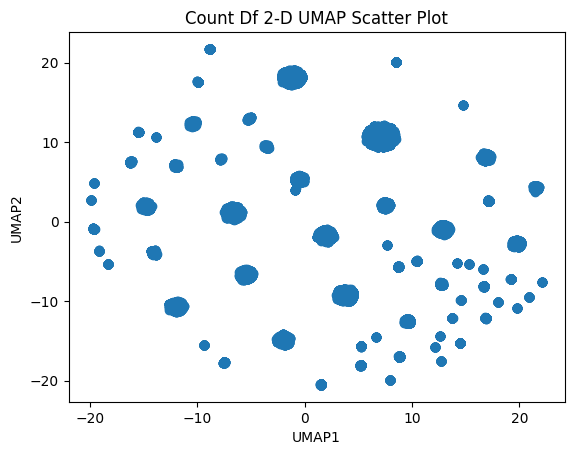

In [18]:
import matplotlib.pyplot as plt

plt.scatter(count_umap_df['UMAP1'], count_umap_df['UMAP2'])
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.title('Count Df 2-D UMAP Scatter Plot')

Text(0.5, 1.0, 'Tfidf Df 2-D UMAP Scatter Plot')

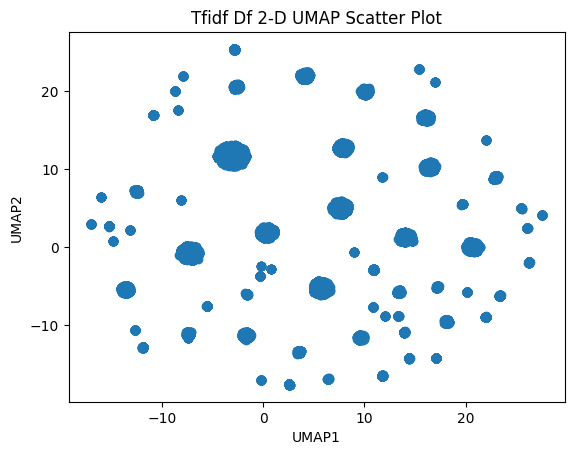

In [19]:
plt.scatter(tfidf_umap_df['UMAP1'], tfidf_umap_df['UMAP2'])
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.title('Tfidf Df 2-D UMAP Scatter Plot')

### 3. Cluster using k-means k=10. Use line separations (like a Voronoi plot) to outline the cluster boundaries. See: http://msmbuilder.org/msmexplorer/development/examples/plot_voronoi.html

### 4. Use marker colors to indicate the real merchant name from the dataset

### 5. Ideally, the markers from steps c and d are the same, but even if they are not, as long as you show the work, you’ll get the full points.

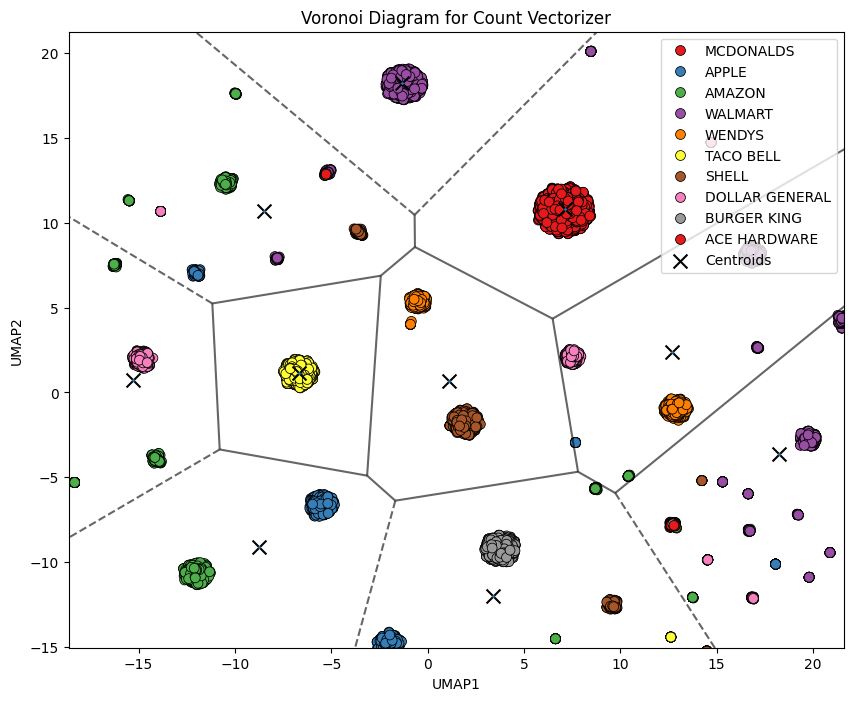

In [20]:
from scipy.spatial import Voronoi, voronoi_plot_2d
from sklearn.cluster import KMeans
import seaborn as sns

def plot_voronoi(umap_df, merchants_data, matrix_type):
    
    kmeans = KMeans(n_clusters=10, random_state=42)
    kmeans.fit(umap_df)

    centroids = kmeans.cluster_centers_

    # Create a Voronoi diagram based on the cluster centers
    vor = Voronoi(centroids)

    # Plot Voronoi regions and boundaries
    fig, ax = plt.subplots(figsize=(10, 8))
    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='black', line_width=1.5, line_alpha=0.6, point_size=2)

    # Plot data points with seaborn using different color markers for each merchant label
    df = count_umap_df.copy()
    df['merchant'] = merchants_data
    sns.scatterplot(data=df, x='UMAP1', y='UMAP2', hue='merchant', palette='Set1', ax=ax, s=50, edgecolor='k', legend='full')

    # Plot cluster centers with a distinct marker
    ax.scatter(centroids[:, 0], centroids[:, 1], color='black', marker='x', s=100, label='Centroids')

    # Show plot
    plt.title('Voronoi Diagram for ' + matrix_type + ' Vectorizer')
    plt.legend()
    plt.show()

plot_voronoi(count_umap_df, count_df_samp['merchant'], 'Count')

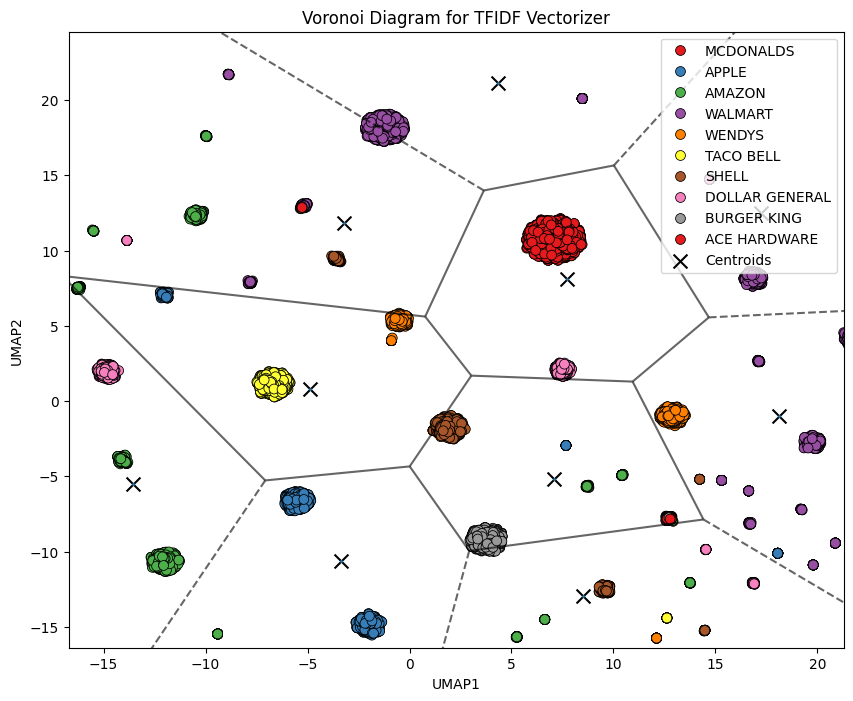

In [21]:
plot_voronoi(tfidf_umap_df, tfidf_df_samp['merchant'], 'TFIDF')

# 2

## Part 1:

Pivot the data into a user/month/total dollars spend aggregation. 

In [22]:
# Load dataset
data_path = '../data/facteus_10k_user_panel.zip'
zipped = zipfile.ZipFile(data_path, 'r')
df = pd.read_csv(zipped.open('facteus_10k_user_panel.csv'))
df.head(10)

,account,date,merchant,merchant_string_example,merchant_ticker,merchant_exchange,transactions,spend,spend_min,spend_max
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPUGLV,AMZN,NASDAQ,2,4.72,1.88,2.84
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,DUNKIN DONUTS,DUNKIN #308696 Q35 IRVINGTON NJUS0EBSE,DNKN,NASDAQ,1,7.33,7.33,7.33
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,EXXON MOBIL,EXXONMOBIL 99243909 NEWARK NJUS1JJWD,XOM,NYSE,1,10.02,10.02,10.02
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,PNC BANK,PNC BANK MAPYJCUN,PNC,NYSE,3,212.44,29.74,102.36
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSOA5ML,AMZN,NASDAQ,3,44.04,10.17,20.94
5,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,IHOP,IHOP #2055 IRVINGTON NJUSZFZBP,DIN,NYSE,1,83.83,83.83,83.83
6,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,PNC BANK,PNC BANK MAPV1IIP,PNC,NYSE,6,811.70,19.66,406.45
7,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,SUBWAY,SUBWAY 00561274 HILLSIDE NJUSXZHFG,NaN,NaN,1,13.75,13.75,13.75
8,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,WAWA,WAWA 8350 00083501 MAPLEWOOD NJUSBHZJA,NaN,NaN,1,14.96,14.96,14.96
9,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-03-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPCVGF,AMZN,NASDAQ,1,21.05,21.05,21.05


In [23]:
# Check number of unique accounts & dates
print(len(df.account.unique()), len(df.date.unique()))

10000 36


In [24]:
# Extract necessary columns
acnt_date_spend = df[['account', 'date', 'spend']].copy()

# Change date format to daily scale
acnt_date_spend['date'] = pd.to_datetime(df['date']).dt.date

# Index by (account, date) pairs
acnt_date_spend.set_index(['account', 'date'], inplace=True)
acnt_date_spend

spend
account                                  date              
a04:512:000ACA1D00B403C9BD4848010BBBCB63 2018-01-01    4.72
                                         2018-01-01    7.33
                                         2018-01-01   10.02
                                         2018-01-01  212.44
                                         2018-02-01   44.04
...                                                     ...
a04:512:E61B330AB05882BB6F20F35565F07E64 2018-02-01  206.00
                                         2018-02-01   13.70
                                         2018-02-01    5.20
                                         2018-02-01   67.57
                                         2018-02-01   30.60

[4242945 rows x 1 columns]

In [25]:
# Aggregate total spend per month for each unique account
acnt_date_spend = acnt_date_spend.groupby(['account', 'date']).sum()
acnt_date_spend

spend
account                                  date               
a04:512:000ACA1D00B403C9BD4848010BBBCB63 2018-01-01   234.51
                                         2018-02-01   968.28
                                         2018-03-01    61.17
                                         2018-04-01   984.02
                                         2018-05-01  1126.64
...                                                      ...
b01:44132:975572515                      2020-08-01   106.35
                                         2020-09-01   816.56
                                         2020-10-01   488.69
                                         2020-11-01   459.72
                                         2020-12-01   308.09

[335028 rows x 1 columns]

In [26]:
# Form pivot table
acnt_date_spend = acnt_date_spend.unstack()
acnt_date_spend

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     234.51     968.28      61.17   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1023.05     860.21    1137.01   
a04:512:0022889224C5EB250061414C9B50B69A        NaN      92.64    2113.45   
a04:512:00247AEF269FF39090229B01ECF0B8CB        NaN        NaN        NaN   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN        NaN   
b01:44132:975106352                             NaN        NaN        NaN   
b01:44132:975433531                             NaN        NaN        NaN   
b01:44132:975544339                             NaN        NaN        NaN   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     984.02    1126.64     223.49   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1096.18    1188.78    1404.04   
a04:512:0022889224C5EB250061414C9B50B69A      36.05        NaN        NaN   
a04:512:00247AEF269FF39090229B01ECF0B8CB     361.30     507.00    1107.90   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN      30.27   
b01:44132:975106352                             NaN        NaN     214.80   
b01:44132:975433531                             NaN        NaN      19.58   
b01:44132:975544339                             NaN        NaN     194.17   
b01:44132:975572515                             NaN        NaN     182.86   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     827.10    1341.73    1886.39   
a04:512:001102B925FF6841524DE5D8774A81A9     534.38     370.07      99.12   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1767.25    1726.61    1246.46   
a04:512:0022889224C5EB250061414C9B50B69A      62.90      60.59     662.64   
a04:512:00247AEF269FF39090229B01ECF0B8CB     475.16     571.03     281.40   
...                                             ...        ...        ...   
b01:44132:975096837                          147.07     245.47     246.57   
b01:44132:975106352                          396.15     281.23     525.12   
b01:44132:975433531                          454.09     742.91     617.08   
b01:44132:975544339                          703.63     688.72     701.59   
b01:44132:975572515                          404.22     834.76     149.77   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63    1476.78  ...     154.17   
a04:512:001102B925FF6841524DE5D8774A81A9     152.60  ...     163.24   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1087.12  ...    1080.18   
a04:512:0022889224C5EB250061414C9B50B69A    1290.17  ...     599.87   
a04:512:00247AEF269FF39090229B01ECF0B8CB    1184.75  ...     336.69   
...                                             ...  ...        ...   
b01:44132:975096837                           57.82  ...     567.06   
b01:44132:975106352                           74.34  ...    1604.79   
b01:44132:975433531         

Remove outliers. At user and user/month levels

Text(0.5, 1.0, 'Number of Null Values per User Histogram')

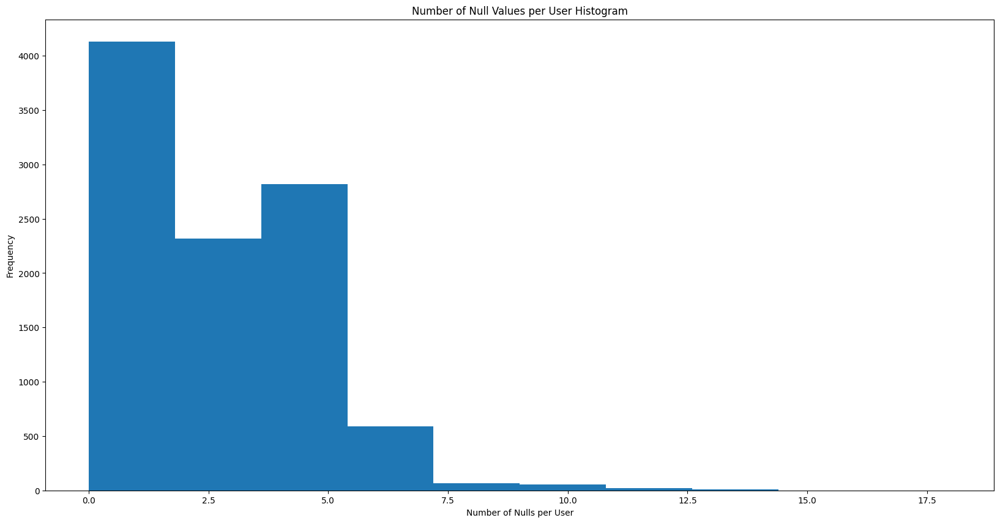

In [27]:
plt.figure(figsize=(20,10))
plt.hist(acnt_date_spend.isna().sum(axis=1))
plt.xlabel('Number of Nulls per User')
plt.ylabel('Frequency')
plt.title('Number of Null Values per User Histogram')

In [28]:
# Erase Users with Number of Nulls > 7
acnt_date_spend1 = acnt_date_spend.loc[acnt_date_spend.isna().sum(axis=1) < 7]
acnt_date_spend1

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     234.51     968.28      61.17   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1023.05     860.21    1137.01   
a04:512:00247AEF269FF39090229B01ECF0B8CB        NaN        NaN        NaN   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     210.50     494.50     794.53   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN        NaN   
b01:44132:975106352                             NaN        NaN        NaN   
b01:44132:975433531                             NaN        NaN        NaN   
b01:44132:975544339                             NaN        NaN        NaN   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     984.02    1126.64     223.49   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1096.18    1188.78    1404.04   
a04:512:00247AEF269FF39090229B01ECF0B8CB     361.30     507.00    1107.90   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     594.39     414.35     739.04   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN      30.27   
b01:44132:975106352                             NaN        NaN     214.80   
b01:44132:975433531                             NaN        NaN      19.58   
b01:44132:975544339                             NaN        NaN     194.17   
b01:44132:975572515                             NaN        NaN     182.86   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     827.10    1341.73    1886.39   
a04:512:001102B925FF6841524DE5D8774A81A9     534.38     370.07      99.12   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1767.25    1726.61    1246.46   
a04:512:00247AEF269FF39090229B01ECF0B8CB     475.16     571.03     281.40   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     508.26     684.11     703.37   
...                                             ...        ...        ...   
b01:44132:975096837                          147.07     245.47     246.57   
b01:44132:975106352                          396.15     281.23     525.12   
b01:44132:975433531                          454.09     742.91     617.08   
b01:44132:975544339                          703.63     688.72     701.59   
b01:44132:975572515                          404.22     834.76     149.77   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63    1476.78  ...     154.17   
a04:512:001102B925FF6841524DE5D8774A81A9     152.60  ...     163.24   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1087.12  ...    1080.18   
a04:512:00247AEF269FF39090229B01ECF0B8CB    1184.75  ...     336.69   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     186.56  ...     363.86   
...                                             ...  ...        ...   
b01:44132:975096837                           57.82  ...     567.06   
b01:44132:975106352                           74.34  ...    1604.79   
b01:44132:975433531         

Text(0.5, 1.0, 'Null Score of Users Histogram')

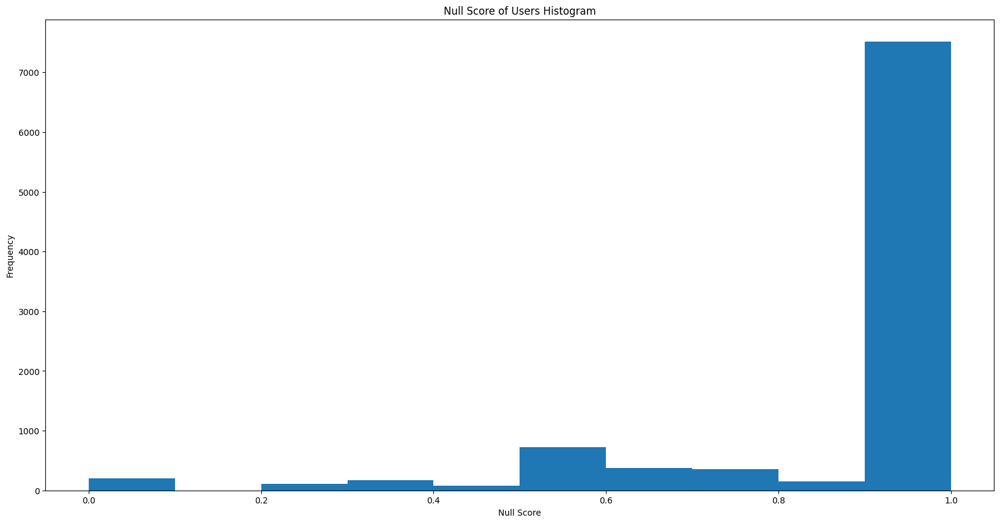

In [29]:
import math

def null_score(row):
    if row.isna().sum() <= 2: # exclude these cases as there are only a few nulls which can be imputed
        return 1
    else:
        denom = 2 + 2*(row.isna().sum()-2)
        numer = 0
        
        row = list(row)
        for i in range(len(row)):
            if i == 0:
                if math.isnan(row[i]) and math.isnan(row[i+1]):
                    numer += 1
            elif i == len(row)-1:
                if math.isnan(row[i]) and math.isnan(row[i-1]):
                    numer += 1
            else:
                if math.isnan(row[i]):
                    if math.isnan(row[i+1]):
                        numer += 1
                    if math.isnan(row[i-1]):
                        numer += 1
    
    return numer/denom

acnt_date_spend2 = acnt_date_spend1.apply(null_score, axis=1)

plt.figure(figsize=(20,10))
plt.hist(acnt_date_spend2)
plt.xlabel('Null Score')
plt.ylabel('Frequency')
plt.title('Null Score of Users Histogram')

In [30]:
# Erase the zero scores
final_acnt_date_spend = acnt_date_spend1.loc[acnt_date_spend2 != 0.0]
final_acnt_date_spend

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     234.51     968.28      61.17   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1023.05     860.21    1137.01   
a04:512:00247AEF269FF39090229B01ECF0B8CB        NaN        NaN        NaN   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     210.50     494.50     794.53   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN        NaN   
b01:44132:975106352                             NaN        NaN        NaN   
b01:44132:975433531                             NaN        NaN        NaN   
b01:44132:975544339                             NaN        NaN        NaN   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     984.02    1126.64     223.49   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1096.18    1188.78    1404.04   
a04:512:00247AEF269FF39090229B01ECF0B8CB     361.30     507.00    1107.90   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     594.39     414.35     739.04   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN      30.27   
b01:44132:975106352                             NaN        NaN     214.80   
b01:44132:975433531                             NaN        NaN      19.58   
b01:44132:975544339                             NaN        NaN     194.17   
b01:44132:975572515                             NaN        NaN     182.86   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     827.10    1341.73    1886.39   
a04:512:001102B925FF6841524DE5D8774A81A9     534.38     370.07      99.12   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1767.25    1726.61    1246.46   
a04:512:00247AEF269FF39090229B01ECF0B8CB     475.16     571.03     281.40   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     508.26     684.11     703.37   
...                                             ...        ...        ...   
b01:44132:975096837                          147.07     245.47     246.57   
b01:44132:975106352                          396.15     281.23     525.12   
b01:44132:975433531                          454.09     742.91     617.08   
b01:44132:975544339                          703.63     688.72     701.59   
b01:44132:975572515                          404.22     834.76     149.77   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63    1476.78  ...     154.17   
a04:512:001102B925FF6841524DE5D8774A81A9     152.60  ...     163.24   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1087.12  ...    1080.18   
a04:512:00247AEF269FF39090229B01ECF0B8CB    1184.75  ...     336.69   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     186.56  ...     363.86   
...                                             ...  ...        ...   
b01:44132:975096837                           57.82  ...     567.06   
b01:44132:975106352                           74.34  ...    1604.79   
b01:44132:975433531         

Impute missing user months using what your team deems the most appropriate method from the fancyimpute package.

#### Withhold 5%

In [31]:
# Assign 'nullable' probability to each position in the final dataset based on 
# null counts on the user and month dimensions

total_nulls = final_acnt_date_spend.isna().sum().sum()
user_null_probs = np.array(final_acnt_date_spend.isna().sum(axis=1)/total_nulls).reshape(-1, 1)
month_null_probs = np.array(final_acnt_date_spend.isna().sum(axis=0)/total_nulls).reshape(1, -1)

null_probs = user_null_probs@month_null_probs
print(null_probs.shape, null_probs.sum())

(9483, 36) 0.9999999999999997


In [32]:
# The support of this pmf should be for non-null values only
null_probs = pd.DataFrame(null_probs)
null_probs.index, null_probs.columns = final_acnt_date_spend.index, final_acnt_date_spend.columns
null_probs *= (~final_acnt_date_spend.isna()) 
null_probs

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63   0.000055   0.000044   0.000033   
a04:512:001102B925FF6841524DE5D8774A81A9   0.000000   0.000000   0.000000   
a04:512:002038B3B84497A0947BAFF4A237C8B1   0.000000   0.000000   0.000000   
a04:512:00247AEF269FF39090229B01ECF0B8CB   0.000000   0.000000   0.000000   
a04:512:002F701CE2B77E5C387D6F56A6947A8B   0.000046   0.000037   0.000028   
...                                             ...        ...        ...   
b01:44132:975096837                        0.000000   0.000000   0.000000   
b01:44132:975106352                        0.000000   0.000000   0.000000   
b01:44132:975433531                        0.000000   0.000000   0.000000   
b01:44132:975544339                        0.000000   0.000000   0.000000   
b01:44132:975572515                        0.000000   0.000000   0.000000   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63   0.000025   0.000015   0.000005   
a04:512:001102B925FF6841524DE5D8774A81A9   0.000000   0.000000   0.000000   
a04:512:002038B3B84497A0947BAFF4A237C8B1   0.000000   0.000000   0.000000   
a04:512:00247AEF269FF39090229B01ECF0B8CB   0.000021   0.000013   0.000004   
a04:512:002F701CE2B77E5C387D6F56A6947A8B   0.000021   0.000013   0.000004   
...                                             ...        ...        ...   
b01:44132:975096837                        0.000000   0.000000   0.000004   
b01:44132:975106352                        0.000000   0.000000   0.000004   
b01:44132:975433531                        0.000000   0.000000   0.000004   
b01:44132:975544339                        0.000000   0.000000   0.000004   
b01:44132:975572515                        0.000000   0.000000   0.000004   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63   0.000004   0.000003   0.000003   
a04:512:001102B925FF6841524DE5D8774A81A9   0.000004   0.000003   0.000003   
a04:512:002038B3B84497A0947BAFF4A237C8B1   0.000000   0.000000   0.000000   
a04:512:00247AEF269FF39090229B01ECF0B8CB   0.000003   0.000003   0.000003   
a04:512:002F701CE2B77E5C387D6F56A6947A8B   0.000003   0.000003   0.000003   
...                                             ...        ...        ...   
b01:44132:975096837                        0.000003   0.000003   0.000003   
b01:44132:975106352                        0.000003   0.000003   0.000003   
b01:44132:975433531                        0.000003   0.000003   0.000003   
b01:44132:975544339                        0.000003   0.000003   0.000003   
b01:44132:975572515                        0.000003   0.000003   0.000003   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63   0.000003  ...   0.000003   
a04:512:001102B925FF6841524DE5D8774A81A9   0.000003  ...   0.000003   
a04:512:002038B3B84497A0947BAFF4A237C8B1   0.000000  ...   0.000000   
a04:512:00247AEF269FF39090229B01ECF0B8CB   0.000002  ...   0.000002   
a04:512:002F701CE2B77E5C387D6F56A6947A8B   0.000002  ...   0.000002   
...                                             ...  ...        ...   
b01:44132:975096837                        0.000002  ...   0.000002   
b01:44132:975106352                        0.000002  ...   0.000002   
b01:44132:975433531         

In [33]:
# Renormalize null probabilities to sum to 1
null_probs /= null_probs.sum().sum()
null_probs.sum().sum()

np.float64(1.0000000000000009)

In [34]:
# Sample data to withhold from null probabilities - first create mask of selected indices
np.random.seed(1)
flat_probs = np.array(null_probs).ravel()
total_datapoints = np.array(null_probs).flatten().shape[0]
sampled_flat_indices = np.random.choice(len(flat_probs), size=int(total_datapoints*0.05), replace=False, p=flat_probs)
sampled_indices = np.unravel_index(sampled_flat_indices, null_probs.shape)
sampled_indices_mask = np.zeros_like(null_probs, dtype=int)
sampled_indices_mask[sampled_indices] = 1
sampled_indices_mask.sum().sum() # we see total number of withheld data points as 5% of the original data as expected

np.int64(17069)

In [35]:
# Store withheld data separately
final_acnt_date_spend_withheld = final_acnt_date_spend*sampled_indices_mask
final_acnt_date_spend_withheld

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     234.51     968.28       0.00   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1       0.00       0.00       0.00   
a04:512:00247AEF269FF39090229B01ECF0B8CB        NaN        NaN        NaN   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     210.50     494.50     794.53   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN        NaN   
b01:44132:975106352                             NaN        NaN        NaN   
b01:44132:975433531                             NaN        NaN        NaN   
b01:44132:975544339                             NaN        NaN        NaN   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63        0.0       0.00       0.00   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1        0.0       0.00       0.00   
a04:512:00247AEF269FF39090229B01ECF0B8CB        0.0     507.00       0.00   
a04:512:002F701CE2B77E5C387D6F56A6947A8B        0.0     414.35       0.00   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN       0.00   
b01:44132:975106352                             NaN        NaN       0.00   
b01:44132:975433531                             NaN        NaN       0.00   
b01:44132:975544339                             NaN        NaN       0.00   
b01:44132:975572515                             NaN        NaN     182.86   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63      827.1       0.00       0.00   
a04:512:001102B925FF6841524DE5D8774A81A9        0.0       0.00       0.00   
a04:512:002038B3B84497A0947BAFF4A237C8B1        0.0       0.00       0.00   
a04:512:00247AEF269FF39090229B01ECF0B8CB        0.0       0.00       0.00   
a04:512:002F701CE2B77E5C387D6F56A6947A8B        0.0       0.00       0.00   
...                                             ...        ...        ...   
b01:44132:975096837                             0.0       0.00       0.00   
b01:44132:975106352                             0.0     281.23       0.00   
b01:44132:975433531                             0.0       0.00       0.00   
b01:44132:975544339                             0.0       0.00       0.00   
b01:44132:975572515                             0.0       0.00     149.77   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63        0.0  ...       0.00   
a04:512:001102B925FF6841524DE5D8774A81A9        0.0  ...       0.00   
a04:512:002038B3B84497A0947BAFF4A237C8B1        0.0  ...       0.00   
a04:512:00247AEF269FF39090229B01ECF0B8CB        0.0  ...       0.00   
a04:512:002F701CE2B77E5C387D6F56A6947A8B        0.0  ...       0.00   
...                                             ...  ...        ...   
b01:44132:975096837                             0.0  ...     567.06   
b01:44132:975106352                             0.0  ...       0.00   
b01:44132:975433531         

In [36]:
# Erase withheld data from original dataset
final_acnt_date_spend_train = (final_acnt_date_spend*(1 - sampled_indices_mask)).replace(0, np.nan)
final_acnt_date_spend_train

spend                        \
date                                     2018-01-01 2018-02-01 2018-03-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63        NaN        NaN      61.17   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1023.05     860.21    1137.01   
a04:512:00247AEF269FF39090229B01ECF0B8CB        NaN        NaN        NaN   
a04:512:002F701CE2B77E5C387D6F56A6947A8B        NaN        NaN        NaN   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN        NaN   
b01:44132:975106352                             NaN        NaN        NaN   
b01:44132:975433531                             NaN        NaN        NaN   
b01:44132:975544339                             NaN        NaN        NaN   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-04-01 2018-05-01 2018-06-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63     984.02    1126.64     223.49   
a04:512:001102B925FF6841524DE5D8774A81A9        NaN        NaN        NaN   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1096.18    1188.78    1404.04   
a04:512:00247AEF269FF39090229B01ECF0B8CB     361.30        NaN    1107.90   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     594.39        NaN     739.04   
...                                             ...        ...        ...   
b01:44132:975096837                             NaN        NaN      30.27   
b01:44132:975106352                             NaN        NaN     214.80   
b01:44132:975433531                             NaN        NaN      19.58   
b01:44132:975544339                             NaN        NaN     194.17   
b01:44132:975572515                             NaN        NaN        NaN   

                                                                           \
date                                     2018-07-01 2018-08-01 2018-09-01   
account                                                                     
a04:512:000ACA1D00B403C9BD4848010BBBCB63        NaN    1341.73    1886.39   
a04:512:001102B925FF6841524DE5D8774A81A9     534.38     370.07      99.12   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1767.25    1726.61    1246.46   
a04:512:00247AEF269FF39090229B01ECF0B8CB     475.16     571.03     281.40   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     508.26     684.11     703.37   
...                                             ...        ...        ...   
b01:44132:975096837                          147.07     245.47     246.57   
b01:44132:975106352                          396.15        NaN     525.12   
b01:44132:975433531                          454.09     742.91     617.08   
b01:44132:975544339                          703.63     688.72     701.59   
b01:44132:975572515                          404.22     834.76        NaN   

                                                     ...             \
date                                     2018-10-01  ... 2020-03-01   
account                                              ...              
a04:512:000ACA1D00B403C9BD4848010BBBCB63    1476.78  ...     154.17   
a04:512:001102B925FF6841524DE5D8774A81A9     152.60  ...     163.24   
a04:512:002038B3B84497A0947BAFF4A237C8B1    1087.12  ...    1080.18   
a04:512:00247AEF269FF39090229B01ECF0B8CB    1184.75  ...     336.69   
a04:512:002F701CE2B77E5C387D6F56A6947A8B     186.56  ...     363.86   
...                                             ...  ...        ...   
b01:44132:975096837                           57.82  ...        NaN   
b01:44132:975106352                           74.34  ...    1604.79   
b01:44132:975433531         

In [37]:
# check ratio of total number of nulls to total number of data points
final_acnt_date_spend_train.isna().sum().sum()/(9483*36)

np.float64(0.11357751297643737)

#### Impute

In [38]:
# Perform imputation on train dataset with KNN
from fancyimpute import KNN

knn_imputer = KNN() 
imputed = knn_imputer.fit_transform(final_acnt_date_spend_train)

Imputing row 1/9483 with 12 missing, elapsed time: 26.936
Imputing row 101/9483 with 9 missing, elapsed time: 26.975
Imputing row 201/9483 with 8 missing, elapsed time: 27.003
Imputing row 301/9483 with 7 missing, elapsed time: 27.035
Imputing row 401/9483 with 0 missing, elapsed time: 27.064
Imputing row 501/9483 with 2 missing, elapsed time: 27.095
Imputing row 601/9483 with 4 missing, elapsed time: 27.120
Imputing row 701/9483 with 6 missing, elapsed time: 27.150
Imputing row 801/9483 with 0 missing, elapsed time: 27.176
Imputing row 901/9483 with 0 missing, elapsed time: 27.208
Imputing row 1001/9483 with 7 missing, elapsed time: 27.235
Imputing row 1101/9483 with 6 missing, elapsed time: 27.261
Imputing row 1201/9483 with 6 missing, elapsed time: 27.292
Imputing row 1301/9483 with 0 missing, elapsed time: 27.322
Imputing row 1401/9483 with 7 missing, elapsed time: 27.347
Imputing row 1501/9483 with 8 missing, elapsed time: 27.378
Imputing row 1601/9483 with 2 missing, elapsed time

Measure and present the distribution of errors by withholding some data 5-10% before the imputation and then measuring the imputed results against the withheld data. Think about how to present this best; do not show raw MSE or MAE values. Ensure that the data withheld matches the missingness pattern of the original dataset. 

Text(0.5, 1.0, 'Absolute Percentage Error of Imputed Data vs. Withheld')

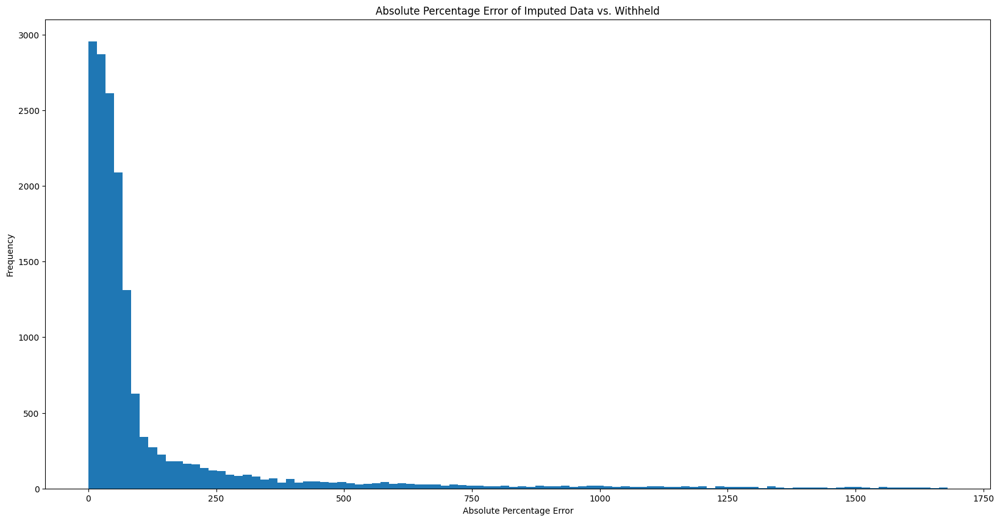

In [39]:
# Compare results with withheld dataset
imputed = pd.DataFrame(imputed)
imputed.index, imputed.columns = final_acnt_date_spend.index, final_acnt_date_spend.columns
div = np.array(final_acnt_date_spend_withheld.fillna(0.0)).flatten()
div = div[div != 0.0]
impute_errors = np.array(((imputed - final_acnt_date_spend_withheld).abs()*sampled_indices_mask).fillna(0.0)).flatten()
impute_errors = 100*impute_errors[impute_errors != 0.0]/div

plt.figure(figsize=(20,10))
# removing outlier predictions for better visibility of errors
plt.hist(impute_errors[impute_errors <= np.percentile(impute_errors, 95)], bins=100) 
plt.xlabel('Absolute Percentage Error')
plt.ylabel('Frequency')
plt.title('Absolute Percentage Error of Imputed Data vs. Withheld')

Text(0.5, 1.0, 'Total Spend vs. Imputation Error')

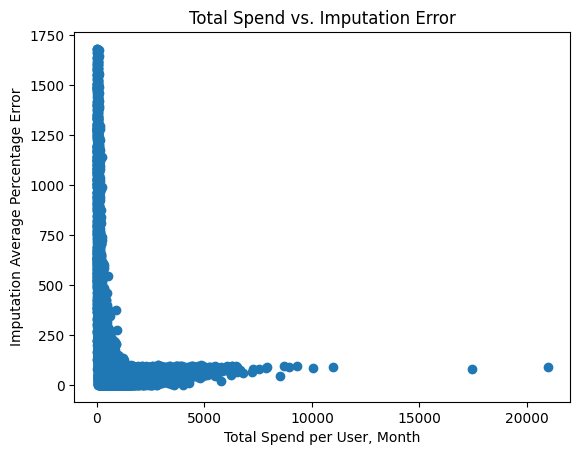

In [40]:
# See error behavior compared to total spend quantities
plt.scatter(div[impute_errors <= np.percentile(impute_errors, 95)], impute_errors[impute_errors <= np.percentile(impute_errors, 95)])
plt.xlabel('Total Spend per User, Month')
plt.ylabel('Imputation Average Percentage Error')
plt.title('Total Spend vs. Imputation Error')
# we see that majority of large errors are concentrated on small total spend amounts below

## Part 2:
Cluster users:

Create two distance metrics of your choice to separate different types of users based on their shopping/spending behavior, as discussed in class. One of the distance metrics should be related to which merchants the users are shopping at, as well as possibly how much they are spending at those merchants. A TFIDF transformation may be appropriate as discussed in class.  Explain your reasoning for picking the distance metrics. Connect the distance metric to a human shopping behavior pattern in your explanation. Give a few pros and cons of describing people's behavior patterns for each of the two metrics of your choice. 

Then cluster the users into 15 clusters on one of the distance metrics. Show the results with a table of top 10 merchants per cluster and the number of users spending money at those merchants per cluster (across all time). Also, show the total number of users per cluster.

In [41]:
# Extract relevant data
acnt_date_merc_spend = df[['account', 'date', 'merchant', 'spend']].copy()
acnt_date_merc_spend['date'] = pd.to_datetime(df['date']).dt.date
acnt_date_merc_spend

,account,date,merchant,spend
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,AMAZON,4.72
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,DUNKIN DONUTS,7.33
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,EXXON MOBIL,10.02
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,PNC BANK,212.44
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01,AMAZON,44.04
...,...,...,...,...
4242940,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,7-ELEVEN,206.00
4242941,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,AMC THEATRES,13.70
4242942,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,ARBYS,5.20
4242943,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,BATH & BODY WORKS,67.57


In [42]:
date_spend_matrices = {} # store (# merchants, # accounts) spend data for each month (month start date)
for d in tqdm(acnt_date_merc_spend.date.unique()): # iterate per date (for efficiency vs. account)
    # aggregate total spend per merchant and account
    cur = acnt_date_merc_spend[acnt_date_merc_spend.date == d].drop(columns=['date']).groupby(['merchant', 'account']).sum().unstack()

    # align index and column levels and naming to allow smooth expansion below
    cur.index.name = None
    cur.columns = cur.columns.droplevel(0)
    cur.columns.name = None

    # expand index to cover all merchants and dates
    cur = cur.reindex(index=acnt_date_merc_spend.merchant.unique(), columns=acnt_date_merc_spend.account.unique())
    date_spend_matrices[d] = cur

100%|██████████| 36/36 [00:56<00:00,  1.56s/it]


In [43]:
for d in date_spend_matrices: # check that the shapes of the matrices are as expected
    print(d, date_spend_matrices[d].shape)

2018-01-01 (1390, 10000)
2018-02-01 (1390, 10000)
2018-03-01 (1390, 10000)
2018-04-01 (1390, 10000)
2018-05-01 (1390, 10000)
2018-06-01 (1390, 10000)
2018-07-01 (1390, 10000)
2018-08-01 (1390, 10000)
2018-09-01 (1390, 10000)
2018-10-01 (1390, 10000)
2018-11-01 (1390, 10000)
2018-12-01 (1390, 10000)
2019-01-01 (1390, 10000)
2019-02-01 (1390, 10000)
2019-03-01 (1390, 10000)
2019-04-01 (1390, 10000)
2019-05-01 (1390, 10000)
2019-06-01 (1390, 10000)
2019-07-01 (1390, 10000)
2019-08-01 (1390, 10000)
2019-09-01 (1390, 10000)
2019-10-01 (1390, 10000)
2019-11-01 (1390, 10000)
2019-12-01 (1390, 10000)
2020-01-01 (1390, 10000)
2020-02-01 (1390, 10000)
2020-03-01 (1390, 10000)
2020-04-01 (1390, 10000)
2020-08-01 (1390, 10000)
2020-12-01 (1390, 10000)
2020-05-01 (1390, 10000)
2020-06-01 (1390, 10000)
2020-07-01 (1390, 10000)
2020-09-01 (1390, 10000)
2020-10-01 (1390, 10000)
2020-11-01 (1390, 10000)


In [44]:
# Manipulate via numpy to obtain (# accounts, # merchants, # months) matrices
acnt_merc_mos = np.transpose(np.stack(list(date_spend_matrices.values()), axis=0), axes=(2, 1, 0))
acnt_merc_mos.shape # note that the ordering of the accounts, merchants, months are preserved from the original data

(10000, 1390, 36)

#### Construct Distance Metrics

In [45]:
acnt_merc_mos[np.isnan(acnt_merc_mos)] = 0.0 # convert nans to zeroes for ease of distance metric calculation

##### Cosine Similarity of Total Spend Time-series

- Why this metric?

This metric measures the cosine distance between the time-series of total spends for each user, where the total spends are aggregated across all merchants for every month. We choose this metric as it offers a high-level intuitive perspective of how users' shopping behavior are similar across time.

- Connection to human shopping behavior

This metric assigns similarity scores based on how much spending amounts are close between users for each month. The underlying rationale is that if two users spend around the same amount at each month, they can be grouped as having similar needs, expenses, and preferences in how they spend around the year.

- Pros

It captures the similarity of different users' spend behavior across time.

- Cons

The similarity of spend behavior across different merchants get lost.

In [46]:
# Define cosine similarity of total spend time-series metric
def cos_sim(x1, x2): # operates on flattened matrices
    # first reshape to matrix form and aggregate in the merchant dimension
    x1 = x1.reshape(acnt_merc_mos.shape[1], acnt_merc_mos.shape[2]).sum(axis=0)
    x2 = x2.reshape(acnt_merc_mos.shape[1], acnt_merc_mos.shape[2]).sum(axis=0)

    # measure cosine similarity
    return (x1@x2)/(np.linalg.norm(x1)*np.linalg.norm(x2))

##### Weighted Jaccard 

- Why this metric?

We choose this metric as it measures the overall similarity across both merchant and month dimensions. It also allows an intuitive explanation of the distance between users as a value close to 1 means that two users spent nearly the same amount at same merchants for each month.

- Connection to human shopping behavior

The metric measures similarity of users' spend allocation across merchants and consistency of shopping behavior across time. For example, the metric successfully divides consistent shoppers versus erratic, one-off purchase shoppers for each merchant - which captures brand-preference and loyalty of the users.

- Pros

It allows a holistic view of the similarity between two users' spending patterns and handles sparse data well while capturing the information contained in the magnitude of spend amounts as well since it works with both overlap and proportionality.

- Cons

It fails to yield meaningful interpretability in edge cases such as when the overlap is perfect but the magnitude of the spend amounts are extremely different (e.g. one user spends little and the other a lot) as in this case the metric will be small even though there is clearly some similarity involved as the two users spend money at exactly the same merchants for every month.

In [47]:
# Define Weighted Jaccard Metric
def weighted_jaccard(x1, x2): # operates on flattened matrices x1, x2
    # x1: of shape (# features,)
    # x2: of shape (# accounts, # features) for vectorization
    intersection = np.sum(np.minimum(x1.reshape(1, -1), x2), axis=1)
    union = np.sum(np.maximum(x1.reshape(1, -1), x2), axis=1)
    return 1 - (intersection / (union + 1e-10)) # reversed as metric needs to be low for distance to be small in clustering

#### Get Clustering Results

In [48]:
from sklearn.cluster import AgglomerativeClustering

# Using cosine similarity for computational reasons
X = np.sum(acnt_merc_mos, axis=-2)
for i in range(X.shape[0]):
    X[i, :] /= np.linalg.norm(X[i, :]) # normalize first for stability in fit downstream
distance_matrix = X@X.T

(array([[7.000e+00, 7.400e+01, 2.730e+02, ..., 2.389e+03, 5.010e+02,
         4.000e+00],
        [5.000e+00, 6.200e+01, 2.620e+02, ..., 2.397e+03, 5.780e+02,
         1.500e+01],
        [0.000e+00, 0.000e+00, 4.000e+00, ..., 3.098e+03, 3.620e+03,
         6.200e+02],
        ...,
        [0.000e+00, 1.600e+01, 8.300e+01, ..., 3.289e+03, 1.266e+03,
         8.000e+00],
        [3.000e+00, 4.100e+01, 1.500e+02, ..., 1.400e+03, 1.150e+02,
         7.000e+00],
        [1.100e+01, 1.500e+02, 4.220e+02, ..., 1.246e+03, 8.300e+01,
         1.000e+00]]),
 array([9.25723866e-04, 1.00833151e-01, 2.00740579e-01, 3.00648007e-01,
        4.00555434e-01, 5.00462862e-01, 6.00370290e-01, 7.00277717e-01,
        8.00185145e-01, 9.00092572e-01, 1.00000000e+00]),
 <a list of 10000 BarContainer objects>)

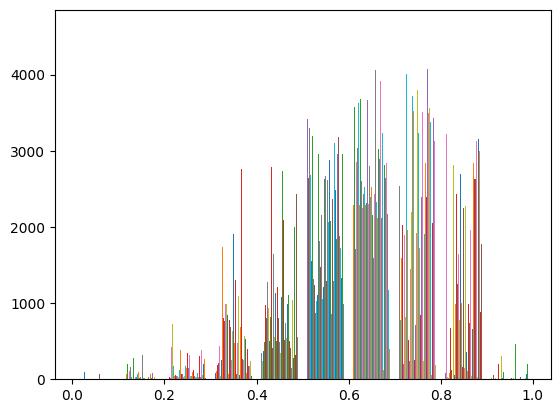

In [49]:
plt.hist(distance_matrix) # see histogram of distance metrics first

In [50]:
# Cluster with cosine similarity
agg_clust = AgglomerativeClustering(n_clusters=15, metric='cosine', linkage='average')
clusters = agg_clust.fit_predict(X)

In [51]:
clusters.shape

(10000,)

In [52]:
acnt_merc_mos.shape

(10000, 1390, 36)

In [53]:
# Identify top 10 merchants, number of users spending money at those merchants, and total number of users per cluster
ordered_merchants = acnt_date_merc_spend.merchant.unique()

clust_mercs = pd.DataFrame(np.concatenate([np.sum(acnt_merc_mos, axis=-1), clusters.reshape(-1, 1)], axis=1))
clust_mercs.columns = list(ordered_merchants) + ['Cluster']
clust_mercs

,AMAZON,DUNKIN DONUTS,EXXON MOBIL,PNC BANK,IHOP,SUBWAY,WAWA,ADVANCE AUTO PARTS INC,SNAPCHAT,ESURANCE,...,CADENCE BANK,GOLDEN PLAINS CU,SEACOMM FCU,UNION BANK & TRUST,TRAVIS CU,LAROSAS PIZZERIA,MCCORMICK & SCHMICKS,MOORES CLOTHING,FAMILY FRESH MARKET,Cluster
0,1181.26,16.51,64.28,23574.01,190.03,20.57,260.81,97.54,5.07,767.92,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,687.14,377.48,62.90,988.67,0.00,102.00,5230.01,0.00,0.00,2117.49,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6774.21,0.00,0.00,0.00,0.00,242.69,0.00,88.12,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,207.49,65.52,151.08,0.00,34.97,97.80,0.00,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,160.34,4.68,0.00,40.01,0.00,9.73,14.19,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,39.65,0.00,0.00,0.00,0.00,7.21,0.00,0.00,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9996,50.21,32.76,0.00,13983.60,0.00,0.00,348.93,140.24,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9997,76.53,52.82,0.00,0.00,0.00,56.25,0.00,56.06,0.00,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9998,1271.93,0.00,0.00,3247.87,158.45,73.88,0.00,0.00,0.00,1992.62,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [54]:
# Get top 10 merchants by total spend per each cluster
clust_merc_sums = clust_mercs.groupby('Cluster').sum()
top_10_columns = clust_merc_sums.apply(lambda row: row.nlargest(10).index.tolist(), axis=1)
top_10_columns = top_10_columns.apply(pd.Series)
top_10_columns.columns = ['Top ' + str(i+1) for i in range(10)]
top_10_columns

,Top 1,Top 2,Top 3,Top 4,Top 5,Top 6,Top 7,Top 8,Top 9,Top 10
Cluster,,,,,,,,,,
0.0,WALMART,7-ELEVEN,AMAZON,U.S. BANK,PNC BANK,KROGER,SQUARE,ATT,T-MOBILE,TARGET
1.0,USPS,WALMART,KROGER,U.S. BANK,SPRINT,AMAZON,PNC BANK,7-ELEVEN,WHOLE FOODS MARKET,LYFT
2.0,WALMART,SQUARE,7-ELEVEN,AMAZON,KROGER,PNC BANK,U.S. BANK,UBER TECHNOLOGIES,LYFT,ATT
3.0,WALMART,U.S. BANK,7-ELEVEN,FAMILY DOLLAR,AMAZON,ATT,UBER TECHNOLOGIES,QUIKTRIP,SUDDENLINK,CRICKET WIRELESS
4.0,WALMART,PNC BANK,7-ELEVEN,U.S. BANK,AMAZON,KROGER,SQUARE,FACEBOOK MESSENGER,METROPCS,MCDONALDS
5.0,WALMART,7-ELEVEN,U.S. BANK,SQUARE,AMAZON,KROGER,PNC BANK,T-MOBILE,MCDONALDS,ATT
6.0,WALMART,7-ELEVEN,AMAZON,SQUARE,USPS,U.S. BANK,APPLE PAY,TARGET,VERIZON,PNC BANK
7.0,EXPEDIA,SQUARE,GEICO,AMAZON,WALMART,ATT,APPLE PAY,T-MOBILE,CARDTRONICS,7-ELEVEN
8.0,SQUARE,WALMART,7-ELEVEN,AMAZON,LYFT,AVIS CAR RENTAL,ENTERPRISE,TD BANK,SAMS CLUB,COSTCO


In [55]:
# Get number of users spending money at top 10 merchants per cluster
for cluster in top_10_columns.index:
    clust_top10 = clust_mercs[clust_mercs['Cluster'] == cluster].drop(columns=['Cluster'])[top_10_columns.loc[cluster]]
    clust_top10[clust_top10 != 0.0] = 1.0
    clust_top10.sum(axis=0)

In [56]:
# Total number of users per cluster
clust_total_users = clust_mercs.groupby('Cluster').count().iloc[:, 0]
clust_total_users.name = 'Total Users'
clust_total_users

Cluster
0.0     9545
1.0        7
2.0      193
3.0        4
4.0       17
5.0       81
6.0       46
7.0        4
8.0        7
9.0        6
10.0       2
11.0      17
12.0       8
13.0      48
14.0      15
Name: Total Users, dtype: int64

# 3

## Part 1:
Augment the main dataset from the previous homework by labeling each company -month into the correct fiscal calendar quarters. The fiscal_calendar.csv mapping file is located at: https://drive.google.com/file/d/1-30QN3aAu9KFLnghOSDbY_JsdVAmxmxp/view?usp=drive_link

Map using tickers and exchange to the main data then augment the main data with period start and end dates for fiscal quarters (not years). Private companies will not be mapped

Our data is monthly, but some fiscal quarters do not start on the first of a month / end on the end date of the final month. For start dates map the date up or down to the closest month. Do the same with end dates. Then when mapping, the first month of the fiscal quarter is inclusive into that quarter, however the end date is only inclusive month prior to the end date..

For example, NASDAQ:JACK 2020-Q3 starts on April 13 and ends on July 5th. So the months of April, May and June are mapped to 2020-Q3. 

Show your work.

**Show your work.**

In [57]:
data_path = '../data/facteus_10k_user_panel.zip'
zipped = zipfile.ZipFile(data_path, 'r')
df = pd.read_csv(zipped.open('facteus_10k_user_panel.csv'))
df.head(10)

,account,date,merchant,merchant_string_example,merchant_ticker,merchant_exchange,transactions,spend,spend_min,spend_max
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPUGLV,AMZN,NASDAQ,2,4.72,1.88,2.84
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,DUNKIN DONUTS,DUNKIN #308696 Q35 IRVINGTON NJUS0EBSE,DNKN,NASDAQ,1,7.33,7.33,7.33
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,EXXON MOBIL,EXXONMOBIL 99243909 NEWARK NJUS1JJWD,XOM,NYSE,1,10.02,10.02,10.02
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01 00:00:00 UTC,PNC BANK,PNC BANK MAPYJCUN,PNC,NYSE,3,212.44,29.74,102.36
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSOA5ML,AMZN,NASDAQ,3,44.04,10.17,20.94
5,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,IHOP,IHOP #2055 IRVINGTON NJUSZFZBP,DIN,NYSE,1,83.83,83.83,83.83
6,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,PNC BANK,PNC BANK MAPV1IIP,PNC,NYSE,6,811.70,19.66,406.45
7,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,SUBWAY,SUBWAY 00561274 HILLSIDE NJUSXZHFG,NaN,NaN,1,13.75,13.75,13.75
8,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01 00:00:00 UTC,WAWA,WAWA 8350 00083501 MAPLEWOOD NJUSBHZJA,NaN,NaN,1,14.96,14.96,14.96
9,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-03-01 00:00:00 UTC,AMAZON,AMAZON MKTPLACE PMTS AMZN.COM/BILLWAUSPCVGF,AMZN,NASDAQ,1,21.05,21.05,21.05


In [58]:
print(type(df['date']))
df['date'] = pd.to_datetime(df['date']).dt.tz_localize(None)
print(type(df['date']))

<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>


In [59]:
print(df['merchant_exchange'].value_counts())

merchant_exchange
NYSE                         1593621
NASDAQ                       1098752
London Stock Exchange         158086
Toronto Stock Exchange        147309
Tokyo Stock Exchange          112468
Euronext Amsterdam             19638
Mexican Stock Exchange          8716
Other                           5546
Stockholm Stock Exchange        4914
OTC                             3287
Tel Aviv Stock Exchange         2452
Swiss Exchange                  1705
American Stock Exchange         1369
Madrid Stock Exchange           1308
Australian Stock Exchange        515
Frankfurt Stock Exchange         484
Irish Stock Exchange             397
Hong Kong Stock Exchange         298
Philippine Stock Exchange        277
Euronext Paris                   156
Euronext Brussels                 88
Korean Stock Exchange             78
Shenzhen Stock Exchange           67
Borsa Italiana                    47
Oslo Stock Exchange               40
Name: count, dtype: int64


In [60]:
exchange_mapping = {
    "NYSE": ["NYSE"],
    "NASDAQ": ["NASDAQ"],
    "London Stock Exchange": ['LON'],
    "Toronto Stock Exchange": ['TSX'],
    "Tokyo Stock Exchange": ['T', 'TYO', 'TSE'],
    "Euronext Amsterdam": ['AMS'], 
    "Mexican Stock Exchange": ["BMV"],
    "Other": ['OTHER'],
    "Stockholm Stock Exchange": ['STO'],
    "OTC": ['OTCMKTS', 'OTCPK'],
    "Tel Aviv Stock Exchange": ['TASE'],
    "Swiss Exchange": ['SWX', 'SIX'],
    "American Stock Exchange": ['NYSE', 'AMEX'],
    "Madrid Stock Exchange": ['BME'],
    "Australian Stock Exchange": ['ASX'],
    "Frankfurt Stock Exchange": ['ETR'],
    "Irish Stock Exchange": ['ISE'],
    "Hong Kong Stock Exchange": ['HKSE'],
    "Philippine Stock Exchange":['PSE'],
    "Euronext Paris": ['EPA'],
    "Euronext Brussels":['BRU'], 
    "Korean Stock Exchange": ['KRX'],
    "Shenzhen Stock Exchange": ['SZSE'],
    "Borsa Italiana": ['BIT'],
    "Oslo Stock Exchange": ['OSE']
}

In [61]:
fiscal_calendar = pd.read_csv('../data/fiscal_calander.csv').dropna()

In [62]:
fiscal_calendar.head(10)

,PERIOD_NAME,PERIOD_TYPE,PERIOD_START_DATE,PERIOD_END_DATE,company_id1,company_id2,PERIOD_NAME_STANDARDIZED
0,Q1-2014,fiscal_quarter,2014-01-01,2014-03-31,005930 KS,KRX:005930,2014-1Q
1,Q1-2014,fiscal_quarter,2014-01-01,2014-03-31,005930 KS,KRX:005930,2014-1Q
2,Q1-2014,fiscal_quarter,2014-01-01,2014-03-31,005930 KS,KRX:005930,2014-1Q
3,Q2-2014,fiscal_quarter,2014-04-01,2014-06-30,005930 KS,KRX:005930,2014-2Q
4,Q2-2014,fiscal_quarter,2014-04-01,2014-06-30,005930 KS,KRX:005930,2014-2Q
5,Q2-2014,fiscal_quarter,2014-04-01,2014-06-30,005930 KS,KRX:005930,2014-2Q
6,Q3-2014,fiscal_quarter,2014-07-01,2014-09-30,005930 KS,KRX:005930,2014-3Q
7,Q3-2014,fiscal_quarter,2014-07-01,2014-09-30,005930 KS,KRX:005930,2014-3Q
8,Q3-2014,fiscal_quarter,2014-07-01,2014-09-30,005930 KS,KRX:005930,2014-3Q
9,Q4-2014,fiscal_quarter,2014-10-01,2014-12-31,005930 KS,KRX:005930,2014-4Q


In [63]:
fiscal_calendar['PERIOD_TYPE'].value_counts()

PERIOD_TYPE
fiscal_quarter      37601
fiscal_year         16536
fiscal_half_year      342
Name: count, dtype: int64

In [64]:
fiscal_calendar = fiscal_calendar[fiscal_calendar['PERIOD_TYPE']=='fiscal_quarter'].drop_duplicates(subset=None, keep='first', inplace=False)

In [65]:
def adjust_start_date(date):
    if date.day <= 15:
        return date + pd.tseries.offsets.MonthBegin(-1)
    else:
        return date + pd.tseries.offsets.MonthBegin(1)

def adjust_end_date(date):
    if date.day <= 15:
        return date + pd.tseries.offsets.MonthEnd(-1)
    else:
        return date + pd.tseries.offsets.MonthEnd(1)

In [66]:
fiscal_calendar['PERIOD_START_DATE'] = pd.to_datetime(fiscal_calendar['PERIOD_START_DATE'])
fiscal_calendar['PERIOD_END_DATE'] = pd.to_datetime(fiscal_calendar['PERIOD_END_DATE'])

In [67]:
fiscal_calendar['ADJUSTED_PERIOD_START_DATE'] = fiscal_calendar['PERIOD_START_DATE'].apply(adjust_start_date)
fiscal_calendar['ADJUSTED_PERIOD_END_DATE'] = fiscal_calendar['PERIOD_END_DATE'].apply(adjust_end_date)

In [68]:
fiscal_calendar

,PERIOD_NAME,PERIOD_TYPE,PERIOD_START_DATE,PERIOD_END_DATE,company_id1,company_id2,PERIOD_NAME_STANDARDIZED,ADJUSTED_PERIOD_START_DATE,ADJUSTED_PERIOD_END_DATE
0,Q1-2014,fiscal_quarter,2014-01-01,2014-03-31,005930 KS,KRX:005930,2014-1Q,2013-12-01,2014-04-30
3,Q2-2014,fiscal_quarter,2014-04-01,2014-06-30,005930 KS,KRX:005930,2014-2Q,2014-03-01,2014-07-31
6,Q3-2014,fiscal_quarter,2014-07-01,2014-09-30,005930 KS,KRX:005930,2014-3Q,2014-06-01,2014-10-31
9,Q4-2014,fiscal_quarter,2014-10-01,2014-12-31,005930 KS,KRX:005930,2014-4Q,2014-09-01,2015-01-31
12,Q1-2015,fiscal_quarter,2015-01-01,2015-03-31,005930 KS,KRX:005930,2015-1Q,2014-12-01,2015-04-30
...,...,...,...,...,...,...,...,...,...
54391,Q4-2021,fiscal_quarter,2021-10-01,2021-12-31,ZNGA US,NASDAQ:ZNGA,2021-4Q,2021-09-01,2022-01-31
54395,Q1-2022,fiscal_quarter,2022-01-01,2022-03-31,ZNGA US,NASDAQ:ZNGA,2022-1Q,2021-12-01,2022-04-30
54399,Q2-2022,fiscal_quarter,2022-04-01,2022-06-30,ZNGA US,NASDAQ:ZNGA,2022-2Q,2022-03-01,2022-07-31
54403,Q3-2022,fiscal_quarter,2022-07-01,2022-09-30,ZNGA US,NASDAQ:ZNGA,2022-3Q,2022-06-01,2022-10-31


In [69]:
fiscal_calendar['prefix'] = fiscal_calendar['company_id2'].str.split(':').str[0]
prefix_counts = fiscal_calendar['prefix'].value_counts()
print(prefix_counts)

prefix
NYSE       7451
NASDAQ     5697
TSX         320
LON         204
TSE         108
TYO          84
EPA          68
OTCMKTS      40
KRX          36
T            36
ETR          36
OTCPK        36
AD           32
SWX          32
BME          32
SIX          28
STO          28
Name: count, dtype: int64


After observing fisical data set, we can see the `company_id1` is not as standardized as `company_id2`. The latter column has more complete exchange and tickers' information. Therefore, we use `company_id2` information to match and help label each company's month into to the fiscal calendar. 

In [70]:
from collections import defaultdict
# Map using tickers and exchange to the main data then augment the main data with period start and end dates for fiscal quarters (not years). 
mapping_dict = defaultdict(list)
for i, x in fiscal_calendar.iterrows():
    mapping_dict[x['company_id2']].append((x['ADJUSTED_PERIOD_START_DATE'], x['ADJUSTED_PERIOD_END_DATE'], x['PERIOD_NAME_STANDARDIZED']))
mapping_dict

defaultdict(list,
            {'KRX:005930': [(Timestamp('2013-12-01 00:00:00'),
               Timestamp('2014-04-30 00:00:00'),
               '2014-1Q'),
              (Timestamp('2014-03-01 00:00:00'),
               Timestamp('2014-07-31 00:00:00'),
               '2014-2Q'),
              (Timestamp('2014-06-01 00:00:00'),
               Timestamp('2014-10-31 00:00:00'),
               '2014-3Q'),
              (Timestamp('2014-09-01 00:00:00'),
               Timestamp('2015-01-31 00:00:00'),
               '2014-4Q'),
              (Timestamp('2014-12-01 00:00:00'),
               Timestamp('2015-04-30 00:00:00'),
               '2015-1Q'),
              (Timestamp('2015-03-01 00:00:00'),
               Timestamp('2015-07-31 00:00:00'),
               '2015-2Q'),
              (Timestamp('2015-06-01 00:00:00'),
               Timestamp('2015-10-31 00:00:00'),
               '2015-3Q'),
              (Timestamp('2015-09-01 00:00:00'),
               Timestamp('2016-01-31 00:00:0

In [71]:
for key in mapping_dict:
    seen = set()
    mapping_dict[key] = [x for x in mapping_dict[key] if not (x in seen or seen.add(x))]
mapping_dict

defaultdict(list,
            {'KRX:005930': [(Timestamp('2013-12-01 00:00:00'),
               Timestamp('2014-04-30 00:00:00'),
               '2014-1Q'),
              (Timestamp('2014-03-01 00:00:00'),
               Timestamp('2014-07-31 00:00:00'),
               '2014-2Q'),
              (Timestamp('2014-06-01 00:00:00'),
               Timestamp('2014-10-31 00:00:00'),
               '2014-3Q'),
              (Timestamp('2014-09-01 00:00:00'),
               Timestamp('2015-01-31 00:00:00'),
               '2014-4Q'),
              (Timestamp('2014-12-01 00:00:00'),
               Timestamp('2015-04-30 00:00:00'),
               '2015-1Q'),
              (Timestamp('2015-03-01 00:00:00'),
               Timestamp('2015-07-31 00:00:00'),
               '2015-2Q'),
              (Timestamp('2015-06-01 00:00:00'),
               Timestamp('2015-10-31 00:00:00'),
               '2015-3Q'),
              (Timestamp('2015-09-01 00:00:00'),
               Timestamp('2016-01-31 00:00:0

In [72]:
# Augment the main dataset from the previous homework by labeling each company month into the correct fiscal calendar quarters. 
tqdm.pandas()
def get_quarter(row):
    merchant_exchange = row['merchant_exchange']
    merchant_ticker = row['merchant_ticker']
    date = row['date']
    if merchant_exchange in exchange_mapping:
        possible_exchanges = exchange_mapping[merchant_exchange]
        for exchange in possible_exchanges:
            company_id = f'{exchange}:{merchant_ticker}'

            if company_id in mapping_dict:
                for period in mapping_dict[company_id]:
                    start_date, end_date, period_name = period
                    if start_date <= date <= end_date:
                        return period_name
    return None

df["fiscal_quarters"] = df.progress_apply(get_quarter, axis=1)

100%|██████████| 4242945/4242945 [00:58<00:00, 72924.46it/s]


**NASDAQ:JACK 2020-Q3** starts on April 13 and ends on July 5. So the months of April, May, and June are mapped to 2020-Q3.

After Adjustment, for the case of  Apr 13 -  Jul 30, we map it to April, May, June and July.

In the case of Apr 29 - Jul 5 it would be mapped to May and June. 

We validate our labeling with **NASDAQ:JACK 2020-Q3** example, where Apr 13 - July 5 would be may to April, May, June. So Jul 1 corresponded to 2020-4Q after adjustment.

In [73]:
df[(df['merchant_ticker'] == 'JACK') & (df['date']=='2020-07-01')]

,account,date,merchant,merchant_string_example,merchant_ticker,merchant_exchange,transactions,spend,spend_min,spend_max,fiscal_quarters
8863,a04:512:00A24EEBB8B74216A56B3459F8E98BCF,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 0453 MOUNTAIN VIEWCAUSC15SE,JACK,NASDAQ,2,16.13,4.98,11.15,2020-4Q
9627,a04:512:00A893AE815F765DBC73FC245568E7AA,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 6418 SIMPSONVILLE SCUSRQAXA,JACK,NASDAQ,1,8.93,8.93,8.93,2020-4Q
16330,a04:512:0112ACBBFA9552E4386614FEF647DB7D,2020-07-01,JACK IN THE BOX,JACK IN THE BOX #3962 HOUSTON TXUSMWWCD,JACK,NASDAQ,1,38.23,38.23,38.23,2020-4Q
20638,a04:512:017C851BE55DB05504AB687111E3F81C,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 0080 NATIONAL CITYCAUSSYQPC,JACK,NASDAQ,1,15.91,15.91,15.91,2020-4Q
28138,a04:512:0209A9D5A05E4B3539253187FAC17B9F,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 5325 RIALTO CAUS15M4X,JACK,NASDAQ,1,10.93,10.93,10.93,2020-4Q
...,...,...,...,...,...,...,...,...,...,...,...
4203333,a04:512:E2D9F7EE184802A211DCD32F583A3277,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 7212 702-385-7022 NVUSDDIEX,JACK,NASDAQ,1,16.22,16.22,16.22,2020-4Q
4220540,a04:512:E42C18E143B3E92D2571D6D145DF6EA7,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 0397 SANTA ANA CAUSZAKPN,JACK,NASDAQ,1,9.04,9.04,9.04,2020-4Q
4229885,a04:512:E4CFFEAF10B2841C242DBA0A3A42517F,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 1153 PHOENIX AZUS10Q2U,JACK,NASDAQ,1,20.03,20.03,20.03,2020-4Q
4236627,a04:512:E58366D4682D3CDF1EDF152731A35E75,2020-07-01,JACK IN THE BOX,JACK IN THE BOX 3472 SACRAMENTO CAUSWYNMT,JACK,NASDAQ,1,6.48,6.48,6.48,2020-4Q


## Part 2

Find total Consolidated (not revenue segments) reported revenues in the revenues_kpi.csv file

https://drive.google.com/file/d/1-GLv7fk97aEvUe930iFLCBJMZURltg8M/view?usp=drive_link

and map to the unique company/quarter from part 1 of this homework + total spend $ per user. Check the data, sometimes the exchanges are not standardized across files, you may need to map the exchanges in revenues_kpi.csv to the ones in the core data manually. 

Remove outlier users, user-months etc. 

Then perform and show a correlation coefficient between core data total spend per quarter and the reported revenues for that quarter for the top 15 companies by total sales in the main data.  Find the ticker/exchange for these merchants and aggregate total spend on the ticker, not the merchant. Show 15 line graphs with 2 lines on each: Total Spend and Reported Revenues. Normalize them first so they are comparable or use two-axis which should normalize itself (pyplot does).

In [74]:
revenue = pd.read_csv("../data/revenues_kpis.csv")
# Find total Consolidated (not revenue segments) reported revenues in the revenues_kpi.csv file.
revenue

,COMPANY_ID,MERCHANT_TICKER,MERCHANT_EXCHANGE,MERCHANT_NAME,FISCAL_QUARTER,KPINAME,KPIVALUE,LASTCONSENSES,IS_PRIMARY_KPI,INCLUDE_TICKER_IN_PANEL_TOTAL
0,18711,ALL,NYSE,CONSOLIDATED,2012-1Q,Revenue,6630.000,6623.85692,1,False
1,18711,ALL,NYSE,CONSOLIDATED,2012-2Q,Revenue,6666.000,6730.87329,1,False
2,18711,ALL,NYSE,CONSOLIDATED,2012-3Q,Revenue,6697.000,6707.32308,1,False
3,18711,ALL,NYSE,CONSOLIDATED,2012-4Q,Revenue,6744.000,6711.58462,1,False
4,18711,ALL,NYSE,CONSOLIDATED,2013-1Q,Revenue,6770.000,6761.77778,1,False
...,...,...,...,...,...,...,...,...,...,...
15355,648976269,DKNG,NASDAQ,CONSOLIDATED,2021-1Q,Revenue,312.000,229.29888,1,True
15356,654692030,IAC,NASDAQ,CONSOLIDATED,2020-2Q,Revenue,726.361,1186.83877,1,True
15357,654692030,IAC,NASDAQ,CONSOLIDATED,2020-3Q,Revenue,788.377,753.48169,1,True
15358,654692030,IAC,NASDAQ,CONSOLIDATED,2020-4Q,Revenue,848.819,774.67859,1,True


In [75]:
revenue['MERCHANT_NAME'].unique()


array(['CONSOLIDATED', 'STARBUCKS', 'SAMS CLUB', 'WALMART'], dtype=object)

In [76]:
revenue['KPINAME'].unique()

array(['Revenue', 'North America Revenue', 'US System-wide SRS USD', nan,
       'US Revenue', 'Americas Company-Operated Stores Revenues',
       'AM Company-Operated Stores Net Revenues USD',
       'US Systemwide Sales USD', "Sam's Club Net Sales",
       'Walmart US Net Sales', 'Cheesecake Factory Restaurant Sale',
       'ATM operations (M)',
       'DNKN US Systemwide & BR US Franchisee Sales UDS',
       'Core Retail OTA', 'Domestic ETSY GMS USD', 'GPV USD',
       'Gross Bookings', 'Systemwide Sales USD'], dtype=object)

In [77]:
# Map to the unique company/quarter from part 1 of this homework + total spend \$ per user
df_grouped = df.groupby(['merchant', 'merchant_ticker','merchant_exchange', 'account', 'fiscal_quarters'])['spend'].sum().reset_index()

In [78]:
df_grouped

,merchant,merchant_ticker,merchant_exchange,account,fiscal_quarters,spend
0,1-800-FLOWERS,FLWS,NASDAQ,a04:512:003EE0EF7B3751C11CCA94F86DE3F5BB,2019-4Q,78.18
1,1-800-FLOWERS,FLWS,NASDAQ,a04:512:01BB701505CB4E269C02522470E97683,2020-4Q,61.63
2,1-800-FLOWERS,FLWS,NASDAQ,a04:512:01BB701505CB4E269C02522470E97683,2021-2Q,170.61
3,1-800-FLOWERS,FLWS,NASDAQ,a04:512:0374D51524324C02EED9592914AEBDF3,2018-4Q,101.84
4,1-800-FLOWERS,FLWS,NASDAQ,a04:512:039FA2D0EA23ADEC8F5A13A75FE5F6DC,2020-4Q,91.49
...,...,...,...,...,...,...
1726863,ZYNGA,ZNGA,NASDAQ,b01:44132:972901326,2020-3Q,5.19
1726864,ZYNGA,ZNGA,NASDAQ,b01:44132:972901326,2020-4Q,1.06
1726865,ZYNGA,ZNGA,NASDAQ,b01:44132:972924162,2018-2Q,297.77
1726866,ZYNGA,ZNGA,NASDAQ,b01:44132:972924162,2018-3Q,404.71


In [79]:
df_grouped[(df_grouped['merchant_ticker'] == 'WMT')&(df_grouped['fiscal_quarters'].str.startswith('2020'))]

,merchant,merchant_ticker,merchant_exchange,account,fiscal_quarters,spend
246085,BONOBOS,WMT,NYSE,a04:512:B6E7048BAC29A9070C8882421BD3A5C8,2020-3Q,95.94
246086,BONOBOS,WMT,NYSE,a04:512:C936C5F871DA818A6E420ADF36CA3E1A,2020-1Q,101.35
246087,BONOBOS,WMT,NYSE,a04:512:C936C5F871DA818A6E420ADF36CA3E1A,2020-3Q,207.84
723646,HAYNEEDLE,WMT,NYSE,a04:512:040D75F1D55B132FAD1BE9C004F97D9F,2020-3Q,177.63
723658,HAYNEEDLE,WMT,NYSE,a04:512:5BDF83E8A20F7E5CA4D5F94E1D6CD2DE,2020-2Q,119.52
...,...,...,...,...,...,...
1650016,WALMART,WMT,NYSE,b01:44132:975544339,2020-4Q,135.76
1650024,WALMART,WMT,NYSE,b01:44132:975572515,2020-1Q,251.60
1650025,WALMART,WMT,NYSE,b01:44132:975572515,2020-2Q,9.77
1650026,WALMART,WMT,NYSE,b01:44132:975572515,2020-3Q,142.67


In [80]:
df_grouped.rename(columns={'merchant_ticker':'MERCHANT_TICKER', 'fiscal_quarters': 'FISCAL_QUARTER', 'merchant_exchange': 'MERCHANT_EXCHANGE'}, inplace=True)

In [81]:
df_grouped['MERCHANT_EXCHANGE'].value_counts()

MERCHANT_EXCHANGE
NYSE                      944403
NASDAQ                    625506
Toronto Stock Exchange     97221
Tokyo Stock Exchange       57638
Swiss Exchange              1179
Madrid Stock Exchange        776
Euronext Paris               145
Name: count, dtype: int64

In [82]:
revenue['MERCHANT_EXCHANGE'].value_counts()

MERCHANT_EXCHANGE
NYSE                         8048
NASDAQ                       5430
Nasdaq                        443
Tokyo Stock Exchange          270
Toronto Stock Exchange        217
TSE                           166
BMV                            94
ENXTPA                         87
LSE                            73
ENXTBR                         72
Euronext Paris                 56
Euronext Amsterdam             54
OM                             54
Hong Kong Stock Exchange       49
ENXTAM                         47
Paris Stock Exchange           37
Swiss Exchange                 36
Oslo Stock Exchange            36
Stockholm Stock Exchange       36
XTRA                           24
Philippine Stock Exchange      11
London Stock Exchange           9
SWX                             8
Irish Stock Exchange            3
Name: count, dtype: int64

In [83]:
df_values = set(df_grouped['MERCHANT_EXCHANGE'].unique())
revenue_values = set(revenue['MERCHANT_EXCHANGE'].unique())

common_values = df_values.intersection(revenue_values)

unique_to_df = df_values.difference(revenue_values)

unique_to_revenue = revenue_values.difference(df_values)

print("common values:", common_values)
print("unique to df:", unique_to_df)
print("unique to revenue:", unique_to_revenue)

common values: {'NYSE', 'NASDAQ', 'Euronext Paris', 'Toronto Stock Exchange', 'Tokyo Stock Exchange', 'Swiss Exchange'}
unique to df: {'Madrid Stock Exchange'}
unique to revenue: {'ENXTAM', 'TSE', 'ENXTBR', 'Hong Kong Stock Exchange', 'Nasdaq', 'ENXTPA', 'Irish Stock Exchange', 'Philippine Stock Exchange', 'SWX', 'Stockholm Stock Exchange', 'XTRA', 'LSE', 'OM', 'Paris Stock Exchange', 'Euronext Amsterdam', 'Oslo Stock Exchange', 'BMV', 'London Stock Exchange'}


In [84]:
r_exchange_mapping = {
    "SWX": "Swiss Exchange",
    "XTRA": "Frankfurt Stock Exchange",
    "TSE": "Tokyo Stock Exchange",
    "ENXTPA": "Euronext Paris",
    "Paris Stock Exchange": "Euronext Paris",
    "OM": "Stockholm Stock Exchange",
    "BMV": "Mexican Stock Exchange",
    "ENXTAM": "Euronext Amsterdam",
    "ENXTBR": "Euronext Brussels",
    "LSE": "London Stock Exchange",
    "Nasdaq": "NASDAQ",
}

In [85]:
revenue['MERCHANT_EXCHANGE'] = revenue['MERCHANT_EXCHANGE'].map(r_exchange_mapping).fillna(revenue['MERCHANT_EXCHANGE'])
revenue

,COMPANY_ID,MERCHANT_TICKER,MERCHANT_EXCHANGE,MERCHANT_NAME,FISCAL_QUARTER,KPINAME,KPIVALUE,LASTCONSENSES,IS_PRIMARY_KPI,INCLUDE_TICKER_IN_PANEL_TOTAL
0,18711,ALL,NYSE,CONSOLIDATED,2012-1Q,Revenue,6630.000,6623.85692,1,False
1,18711,ALL,NYSE,CONSOLIDATED,2012-2Q,Revenue,6666.000,6730.87329,1,False
2,18711,ALL,NYSE,CONSOLIDATED,2012-3Q,Revenue,6697.000,6707.32308,1,False
3,18711,ALL,NYSE,CONSOLIDATED,2012-4Q,Revenue,6744.000,6711.58462,1,False
4,18711,ALL,NYSE,CONSOLIDATED,2013-1Q,Revenue,6770.000,6761.77778,1,False
...,...,...,...,...,...,...,...,...,...,...
15355,648976269,DKNG,NASDAQ,CONSOLIDATED,2021-1Q,Revenue,312.000,229.29888,1,True
15356,654692030,IAC,NASDAQ,CONSOLIDATED,2020-2Q,Revenue,726.361,1186.83877,1,True
15357,654692030,IAC,NASDAQ,CONSOLIDATED,2020-3Q,Revenue,788.377,753.48169,1,True
15358,654692030,IAC,NASDAQ,CONSOLIDATED,2020-4Q,Revenue,848.819,774.67859,1,True


In [86]:
df_grouped = pd.merge(df_grouped, revenue[['MERCHANT_TICKER', 'MERCHANT_EXCHANGE', 'FISCAL_QUARTER', 'KPINAME', 'KPIVALUE']], on = ['MERCHANT_TICKER', 'MERCHANT_EXCHANGE', 'FISCAL_QUARTER'], how='left')

Text(0.5, 1.0, 'Spend Data Distribution')

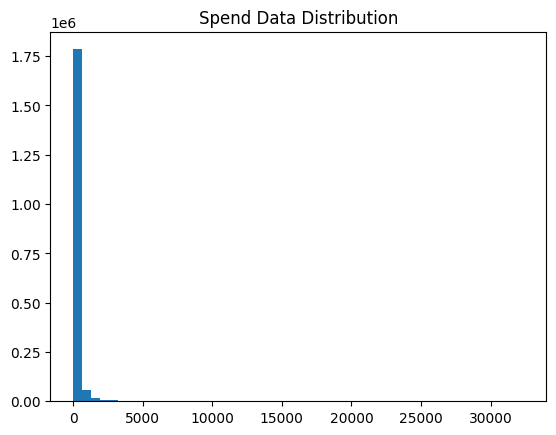

In [87]:
plt.hist(df_grouped['spend'], bins=50)
plt.title('Spend Data Distribution')

In [88]:
# Remove outlier users
df_grouped = df_grouped[df_grouped['spend'] < np.percentile(df_grouped['spend'], 95)]

In [89]:
#  Remove outlier at user_quarter level
df_grouped = df_grouped.groupby('FISCAL_QUARTER').apply(lambda x: x[x['spend'] < np.percentile(x['spend'], 95)])  
df_grouped

merchant MERCHANT_TICKER MERCHANT_EXCHANGE  \
FISCAL_QUARTER                                                             
-2019-4Q       1552641  VITAMIN SHOPPE             FRG            NASDAQ   
               1552655  VITAMIN SHOPPE             FRG            NASDAQ   
               1552659  VITAMIN SHOPPE             FRG            NASDAQ   
               1552669  VITAMIN SHOPPE             FRG            NASDAQ   
               1552673  VITAMIN SHOPPE             FRG            NASDAQ   
...                                ...             ...               ...   
2021-4Q        1872120           ZALES             SIG              NYSE   
               1872131           ZALES             SIG              NYSE   
               1872147           ZALES             SIG              NYSE   
               1872149           ZALES             SIG              NYSE   
               1872151           ZALES             SIG              NYSE   

                                                         account  \
FISCAL_QUARTER                                                     
-2019-4Q       1552641  a04:512:0C3ED7C5973527A3F17AFC2146D76E54   
               1552655  a04:512:161676DD690B85A1A7C4CCF745D8520C   
               1552659  a04:512:19AC012751A7B6105911BC59C29A3220   
               1552669  a04:512:23A263114A7EAD7A3E6A93D99AA893AE   
               1552673  a04:512:291BACB7A85292738CE724AEF0A62A10   
...                                                          ...   
2021-4Q        1872120  a04:512:E3F232F4A6FC96E27D30972B46A91EDC   
               1872131  a04:512:F5F7D4C3E1C4B603E4E2A8398107CBEB   
               1872147                       b01:44132:934996711   
               1872149                       b01:44132:941849039   
               1872151                       b01:44132:947958388   

                       FISCAL_QUARTER   spend  KPINAME  KPIVALUE  
FISCAL_QUARTER                                                    
-2019-4Q       1552641       -2019-4Q   10.19      NaN       NaN  
               1552655       -2019-4Q   84.44      NaN       NaN  
               1552659       -2019-4Q    4.20      NaN       NaN  
               1552669       -2019-4Q   13.56      NaN       NaN  
               1552673       -2019-4Q   13.77      NaN       NaN  
...                               ...     ...      ...       ...  
2021-4Q        1872120        2021-4Q  116.83  Revenue    2186.5  
               1872131        2021-4Q   90.27  Revenue    2186.5  
               1872147        2021-4Q   27.27  Revenue    2186.5  
               1872149        2021-4Q   84.80  Revenue    2186.5  
               1872151        2021-4Q  106.18  Revenue    2186.5  

[1691605 rows x 8 columns]

In [90]:
df_grouped.reset_index(drop=True, inplace=True)
df_grouped

,merchant,MERCHANT_TICKER,MERCHANT_EXCHANGE,account,FISCAL_QUARTER,spend,KPINAME,KPIVALUE
0,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:0C3ED7C5973527A3F17AFC2146D76E54,-2019-4Q,10.19,NaN,NaN
1,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:161676DD690B85A1A7C4CCF745D8520C,-2019-4Q,84.44,NaN,NaN
2,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:19AC012751A7B6105911BC59C29A3220,-2019-4Q,4.20,NaN,NaN
3,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:23A263114A7EAD7A3E6A93D99AA893AE,-2019-4Q,13.56,NaN,NaN
4,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:291BACB7A85292738CE724AEF0A62A10,-2019-4Q,13.77,NaN,NaN
...,...,...,...,...,...,...,...,...
1691600,ZALES,SIG,NYSE,a04:512:E3F232F4A6FC96E27D30972B46A91EDC,2021-4Q,116.83,Revenue,2186.5
1691601,ZALES,SIG,NYSE,a04:512:F5F7D4C3E1C4B603E4E2A8398107CBEB,2021-4Q,90.27,Revenue,2186.5
1691602,ZALES,SIG,NYSE,b01:44132:934996711,2021-4Q,27.27,Revenue,2186.5
1691603,ZALES,SIG,NYSE,b01:44132:941849039,2021-4Q,84.80,Revenue,2186.5


In [91]:
# achieve the top 15 companies by total sales in the main data
top_firms = df_grouped.groupby(['MERCHANT_TICKER', 'MERCHANT_EXCHANGE'])['KPIVALUE'].sum()

In [92]:
top_firms

MERCHANT_TICKER  MERCHANT_EXCHANGE   
3382             Tokyo Stock Exchange    4.474550e+08
4755             Tokyo Stock Exchange    1.888249e+05
4911             Tokyo Stock Exchange    7.384791e+03
6758             Tokyo Stock Exchange    2.378564e+08
7974             Tokyo Stock Exchange    8.346390e+06
                                             ...     
WU               NYSE                    3.011784e+06
WWE              NYSE                    1.680326e+05
XOM              NYSE                    8.337626e+08
YUM              NYSE                    1.219808e+08
ZNGA             NASDAQ                  1.915345e+05
Name: KPIVALUE, Length: 309, dtype: float64

In [93]:
top_15 = top_firms.sort_values(ascending=False).head(15).index
top_15

MultiIndex([( 'WMT',                 'NYSE'),
            ('AAPL',               'NASDAQ'),
            ('AMZN',               'NASDAQ'),
            ( 'CVS',                 'NYSE'),
            ( 'WBA',               'NASDAQ'),
            ( 'CVX',                 'NYSE'),
            ( 'MCD',                 'NYSE'),
            (  'KR',                 'NYSE'),
            ( 'XOM',                 'NYSE'),
            (   'T',                 'NYSE'),
            ( 'MPC',                 'NYSE'),
            ( 'TGT',                 'NYSE'),
            ('MSFT',               'NASDAQ'),
            ('3382', 'Tokyo Stock Exchange'),
            ('DLTR',               'NASDAQ')],
           names=['MERCHANT_TICKER', 'MERCHANT_EXCHANGE'])

In [94]:
tickers = top_15.get_level_values('MERCHANT_TICKER').tolist()
print(tickers)

['WMT', 'AAPL', 'AMZN', 'CVS', 'WBA', 'CVX', 'MCD', 'KR', 'XOM', 'T', 'MPC', 'TGT', 'MSFT', '3382', 'DLTR']


In [95]:
df_groups_top = df_grouped[df_grouped['MERCHANT_TICKER'].isin(tickers)]
revs, spends = [], []

for quarter, df_quarter in df_groups_top.groupby('FISCAL_QUARTER'):
    rev_sum = df_quarter.groupby('MERCHANT_TICKER')['KPIVALUE'].sum()
    spend_sum = df_quarter.groupby('MERCHANT_TICKER')['spend'].sum()
    revs.append(rev_sum)
    spends.append(spend_sum)

In [96]:
revs = pd.concat(revs, axis=1)
revs

,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE,KPIVALUE
MERCHANT_TICKER,,,,,,,,,,,,,,,,,
AMZN,43792548.0,81083275.0,107219277.0,126641076.0,1.892037e+08,1.634818e+08,1.773400e+08,2.082014e+08,2.777371e+08,2.501006e+08,2.993544e+08,3.242953e+08,3.718325e+08,NaN,NaN,NaN,NaN
CVS,30337395.0,82293093.0,102664184.0,111413033.0,1.310530e+08,1.589850e+08,1.531859e+08,1.525627e+08,1.599985e+08,1.714936e+08,1.544008e+08,1.375319e+08,1.102431e+08,NaN,NaN,NaN,NaN
CVX,25202720.0,67673088.0,101155220.0,107636189.0,9.961190e+07,8.821120e+07,9.743580e+07,8.689510e+07,8.378675e+07,6.744364e+07,3.164343e+07,5.555267e+07,4.089852e+07,NaN,NaN,NaN,NaN
DLTR,9365868.6,24796499.0,32437130.4,33260649.6,4.071420e+07,3.591578e+07,3.593298e+07,3.552586e+07,4.042067e+07,3.825029e+07,3.186033e+07,3.398303e+07,1.975426e+07,NaN,NaN,NaN,NaN
KR,20514973.0,75182520.0,63169533.0,56025231.0,7.180573e+07,9.862884e+07,6.892004e+07,5.916274e+07,6.727794e+07,9.443128e+07,5.126576e+07,5.631166e+07,5.570570e+07,NaN,NaN,NaN,NaN
MCD,23233440.0,49928247.2,69833510.7,71860995.0,7.012357e+07,6.906488e+07,7.591675e+07,7.548806e+07,7.343461e+07,6.744927e+07,6.529016e+07,6.999407e+07,5.769619e+07,NaN,NaN,NaN,NaN
MPC,12677892.0,30165576.0,49648340.0,51329908.0,6.963774e+07,6.990644e+07,8.765618e+07,9.625817e+07,9.914500e+07,7.137312e+07,4.621712e+07,5.069617e+07,3.715604e+07,NaN,NaN,NaN,NaN
T,25255656.0,48156108.0,62065712.0,72999444.0,7.856454e+07,7.660934e+07,7.220094e+07,6.710494e+07,7.154249e+07,6.579410e+07,6.146595e+07,5.914898e+07,5.661115e+07,NaN,NaN,NaN,NaN
TGT,13220910.0,27917631.0,36735244.0,40134136.0,6.433672e+07,4.472136e+07,4.463554e+07,4.528316e+07,6.449644e+07,5.279286e+07,5.217110e+07,5.291528e+07,4.143786e+07,NaN,NaN,NaN,NaN


In [97]:
spends = pd.concat(spends, axis=1)

In [98]:
revs.columns = list(df_groups_top['FISCAL_QUARTER'].unique())
spends.columns = list(df_groups_top['FISCAL_QUARTER'].unique())
spends

,2017-4Q,2018-1Q,2018-2Q,2018-3Q,2018-4Q,2019-1Q,2019-2Q,2019-3Q,2019-4Q,2020-1Q,2020-2Q,2020-3Q,2020-4Q,2021-1Q,2021-2Q,2021-3Q,2021-4Q
MERCHANT_TICKER,,,,,,,,,,,,,,,,,
AMZN,51609.03,198848.99,223257.16,247828.18,358301.63,409373.68,389411.56,423919.67,498234.69,587190.32,615529.88,574656.74,438725.74,NaN,NaN,NaN,NaN
CVS,18529.41,69808.46,77569.41,86238.84,97595.82,116891.71,101404.47,89398.09,99735.14,129393.22,117321.58,91427.51,64529.14,NaN,NaN,NaN,NaN
CVX,18535.47,75892.79,104556.28,105034.94,103344.51,121000.43,120719.92,119816.01,115990.31,111110.74,121152.15,118063.26,68756.59,NaN,NaN,NaN,NaN
DLTR,39775.79,178793.25,218531.64,229323.07,263078.13,285428.82,265751.89,267887.30,290004.41,342591.23,248463.59,269282.57,96357.57,NaN,NaN,NaN,NaN
KR,42774.65,143112.27,157645.30,136132.54,181757.13,231956.24,203326.86,167103.50,207789.50,256365.81,145822.56,162568.65,147639.56,NaN,NaN,NaN,NaN
MCD,47295.75,218635.45,278557.62,304218.01,304733.75,345298.86,337703.54,338863.77,335186.99,376648.15,397328.31,378683.81,221978.52,NaN,NaN,NaN,NaN
MPC,18385.79,65141.25,93393.60,95120.19,101366.55,122251.92,133170.05,161118.91,179117.90,166515.75,167755.51,155038.64,95381.10,NaN,NaN,NaN,NaN
T,46811.43,133958.39,161140.24,160634.54,202306.28,234447.41,219064.02,197697.38,212945.75,234864.76,226939.10,203302.14,151343.97,NaN,NaN,NaN,NaN
TGT,31270.82,123615.49,149307.23,158941.53,228655.77,218697.80,189954.44,203254.76,233297.55,304373.89,299529.70,277090.73,145142.43,NaN,NaN,NaN,NaN


In [99]:
def row_correlation(row1, row2):
    return np.corrcoef(row1, row2)[0, 1]

# Calculate row-wise correlation
correlations = [
    row_correlation(revs.iloc[i].dropna(), spends.iloc[i].dropna()) for i in range(len(revs))
]

correlation_series = pd.Series(correlations)
correlation_series

0     0.867456
1     0.938344
2     0.548137
3     0.950345
4     0.907508
5     0.883256
6     0.755162
7     0.837201
8     0.842030
9     0.796831
10    0.633706
11    0.922154
12    0.906352
13    0.452803
14    0.990564
dtype: float64

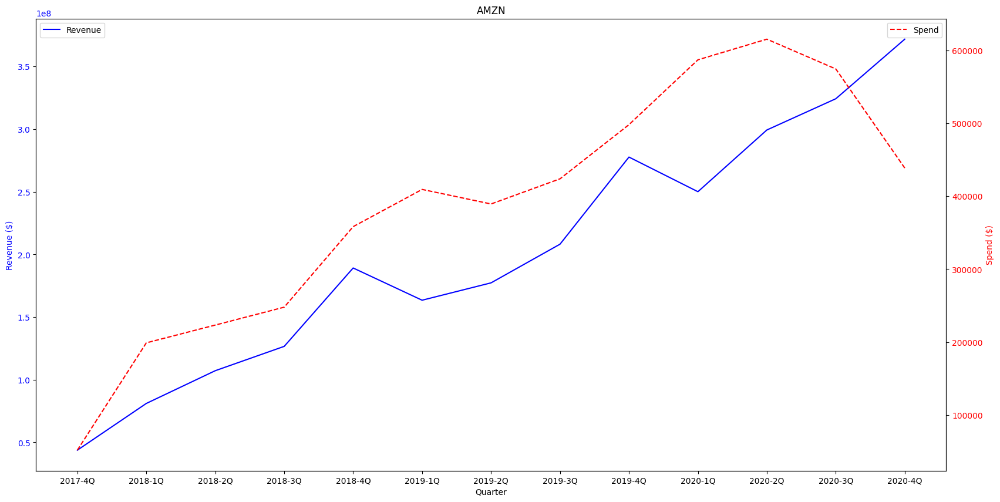

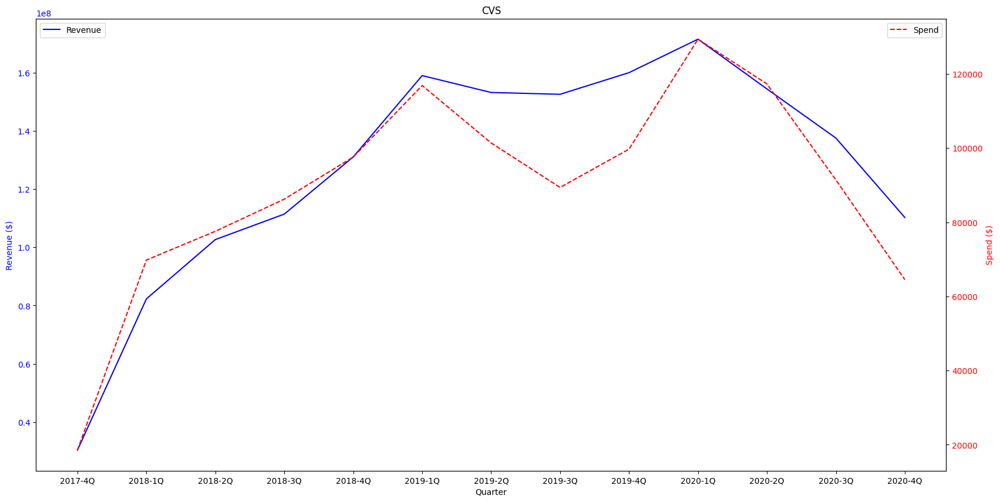

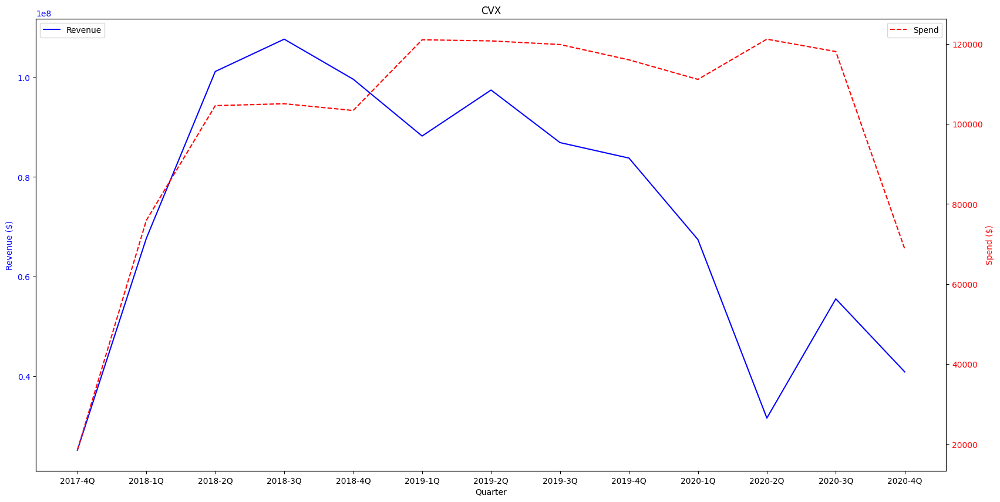

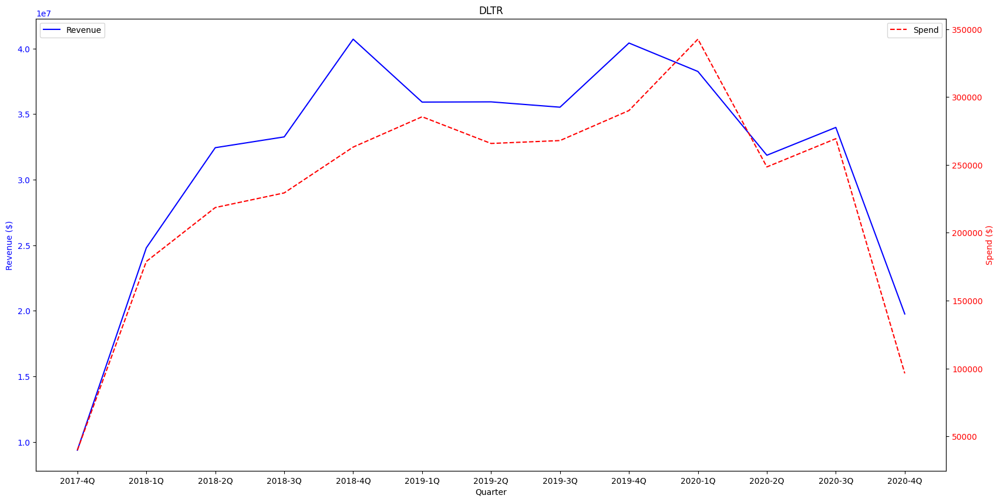

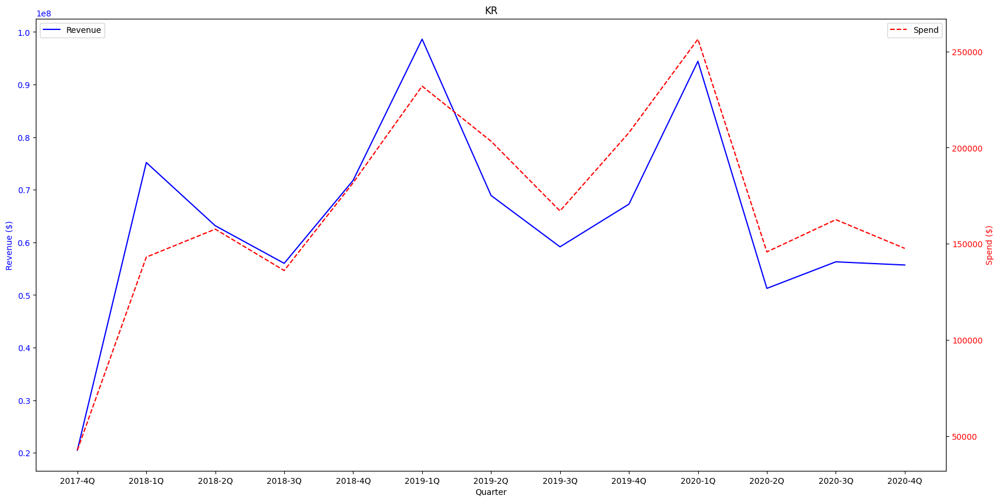

...

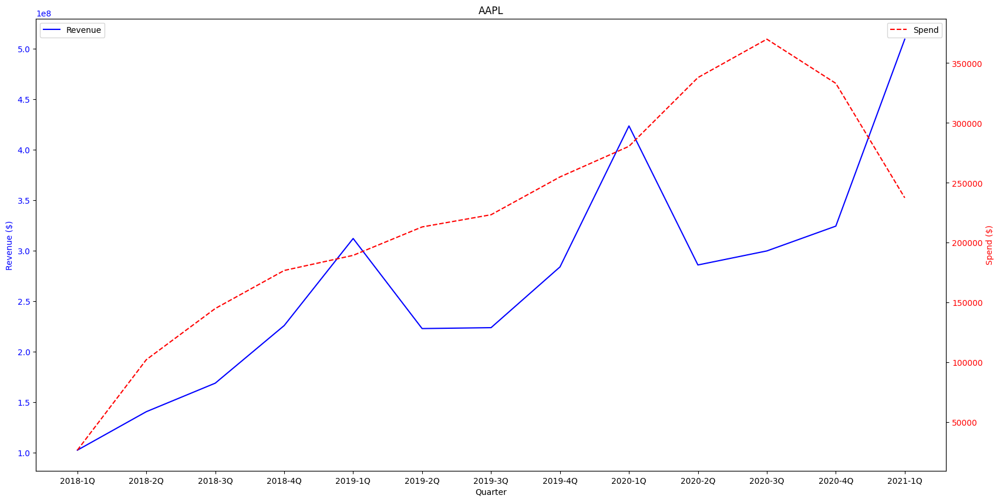

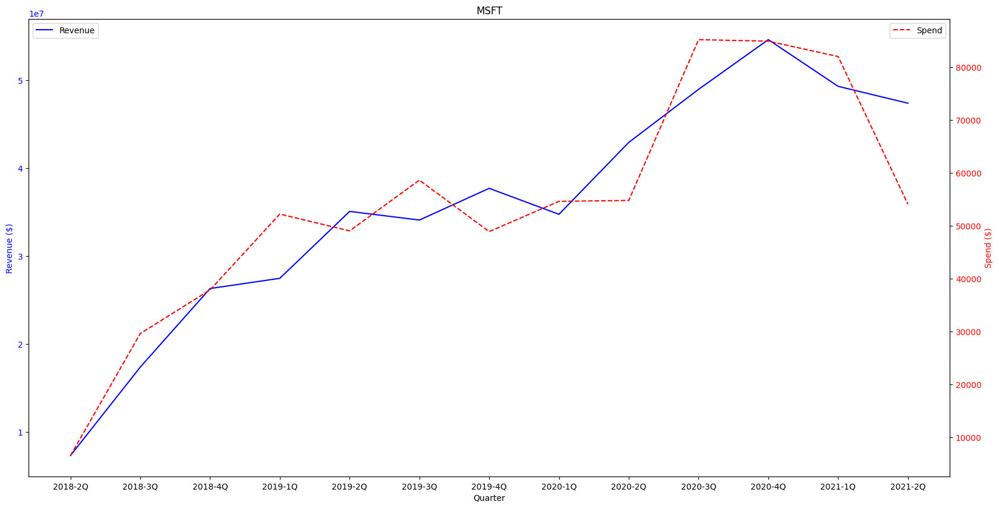

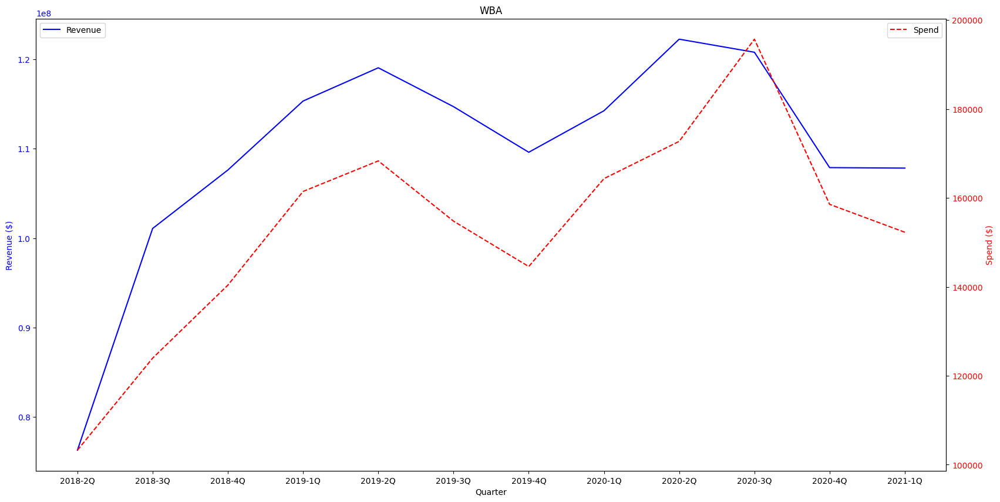

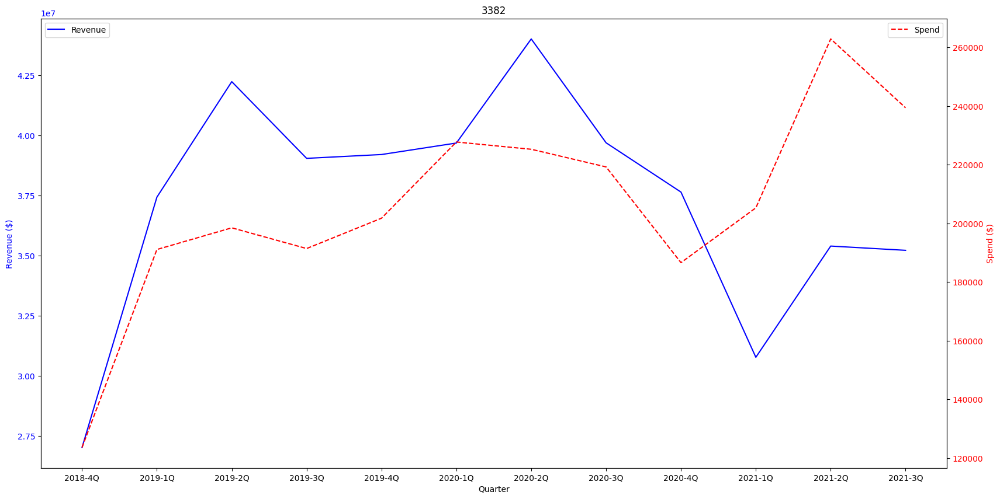

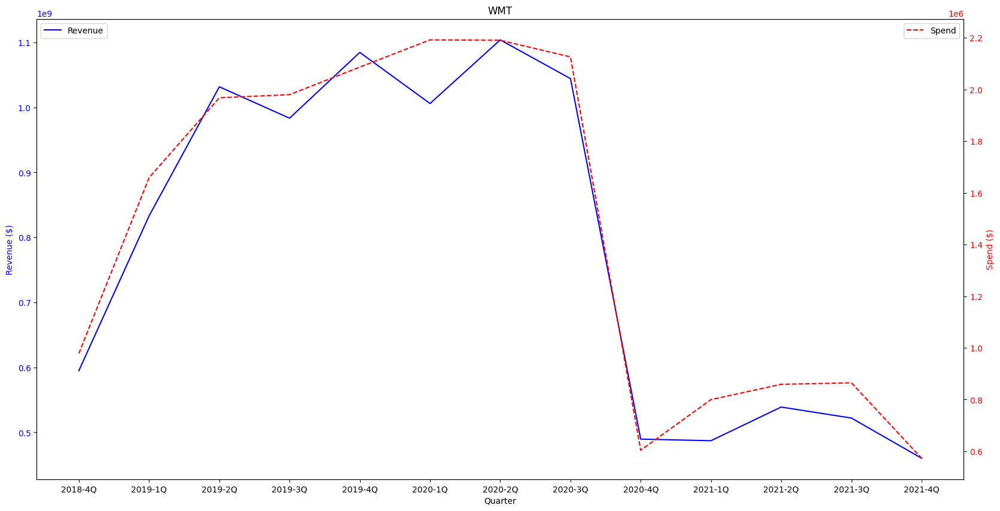

In [100]:
# Show 15 line graphs with 2 lines on each: Total Spend and Reported Revenues
for i in range(len(revs)):

    fig, ax1 = plt.subplots(figsize=(20,10))
    ax1.plot(revs.columns, revs.iloc[i], 'b-', label='Revenue')
    ax1.set_xlabel('Quarter')
    ax1.set_ylabel('Revenue ($)', color='b')
    ax1.tick_params(axis='y', labelcolor='b')
    ax2 = ax1.twinx()
    ax2.plot(revs.columns, spends.iloc[i], 'r--', label='Spend')
    ax2.set_ylabel('Spend ($)', color='r')
    ax2.tick_params(axis='y', labelcolor='r')
    plt.title(revs.index[i])
    ax1.legend(loc='upper left')
    ax2.legend(loc='upper right')
    plt.show()

## Part 3:

For NYSE:WMT, read the sources (see below) for Fiscal 2020 and find their reporting segments. Each segment has segment revenues / net sales numbers reported. Find the correct combination of reporting revenue segments to map to our data's NYSE:WMTcompany. Remember, our data is U.S. (including Porto Rico) only.

Once you have identified the revenue segments, create a mapping table. For each fiscal quarter find the appropriate "apples-to-apples" Net sales numbers. Create a total revenue mapping between WMT fiscal quarters "apples-to-apples" total reported Net sales and the sum of spend for that quarter in our data (using the mapping from step 1).

You can use the company's 10-Q and 10-K's to get this data, quarterly Earnings Presentations or any other source.

Show your work.

In [101]:
df_wmt = df_grouped[df_grouped['MERCHANT_TICKER'] == 'WMT']
df_wmt

,merchant,MERCHANT_TICKER,MERCHANT_EXCHANGE,account,FISCAL_QUARTER,spend,KPINAME,KPIVALUE
362276,HAYNEEDLE,WMT,NYSE,a04:512:2C2961F27E4ADFDC9DA801276BD7A0AB,2018-4Q,44.14,Sam's Club Net Sales,15479.0
362277,HAYNEEDLE,WMT,NYSE,a04:512:2C2961F27E4ADFDC9DA801276BD7A0AB,2018-4Q,44.14,Walmart US Net Sales,86579.0
362278,HAYNEEDLE,WMT,NYSE,a04:512:2C2961F27E4ADFDC9DA801276BD7A0AB,2018-4Q,44.14,Walmart US Net Sales,86579.0
362279,HAYNEEDLE,WMT,NYSE,a04:512:8EABC9465609D6603E10FD0AF2A1487E,2018-4Q,201.95,Sam's Club Net Sales,15479.0
362280,HAYNEEDLE,WMT,NYSE,a04:512:8EABC9465609D6603E10FD0AF2A1487E,2018-4Q,201.95,Walmart US Net Sales,86579.0
...,...,...,...,...,...,...,...,...
1691581,WALMART,WMT,NYSE,b01:44132:973710379,2021-4Q,316.55,Walmart US Net Sales,99600.0
1691582,WALMART,WMT,NYSE,b01:44132:974188721,2021-4Q,328.55,Walmart US Net Sales,99600.0
1691583,WALMART,WMT,NYSE,b01:44132:975096837,2021-4Q,109.27,Walmart US Net Sales,99600.0
1691584,WALMART,WMT,NYSE,b01:44132:975106352,2021-4Q,264.22,Walmart US Net Sales,99600.0


In [102]:
wmt_2020 = df_wmt[
    (df_wmt['FISCAL_QUARTER'].str.startswith('2020')) & 
    (df_wmt['MERCHANT_TICKER'] == 'WMT')
]

In [103]:
print(wmt_2020['MERCHANT_EXCHANGE'].value_counts())

MERCHANT_EXCHANGE
NYSE    57762
Name: count, dtype: int64


In [104]:
temp = wmt_2020.groupby(['FISCAL_QUARTER', 'KPINAME'])['KPIVALUE'].first()*1e+6
temp = pd.DataFrame(temp.groupby('FISCAL_QUARTER').sum())
temp['net_sales'] = [94164, 100249, 97814, 107569]
temp['KPIVALUE']/(temp['net_sales']*1e+6)

FISCAL_QUARTER
2020-1Q    1.000106
2020-2Q    1.000000
2020-3Q    1.000000
2020-4Q    0.857784
dtype: float64

In [105]:
temp # Revenues from KPIVALUE vs. Net Sales (in millions)

,KPIVALUE,net_sales
FISCAL_QUARTER,,
2020-1Q,9.417400e+10,94164
2020-2Q,1.002490e+11,100249
2020-3Q,9.781400e+10,97814
2020-4Q,9.227100e+10,107569


## Part 5

Use an optimizer to create weights, one per each cluster from HW2 which minimized MAPE between the reported revenues and total spend from our data.

The weights should be constrained to be between 1 and 15

To calculate the MAPE you need to normalize the data for each company first.

Use the following companies in your analysis:

(WALMART, MCDONALDS, AMAZON, APPLE,  WENDYS, TACO BELL, BURGER KING, DOLLAR GENERAL). Find the ticker/exchange for these merchants and aggregate total spend on the ticker, not the merchant. 

The optimization function should multiply each cluster's spend by the weight, then sum all clusters, then aggregate the total by Company/Fiscal Quarter from Part 2, compare to company revenues using MAPE (normalize first), calculate the total MAPE across all company quarters.

Optimize the weights to minimize the total MAPE

Show your work and results. Show the revenues, total spend, and MAPE for each company quarter and the total MAPE. Show each cluster's weights.

In [106]:
df_grouped

,merchant,MERCHANT_TICKER,MERCHANT_EXCHANGE,account,FISCAL_QUARTER,spend,KPINAME,KPIVALUE
0,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:0C3ED7C5973527A3F17AFC2146D76E54,-2019-4Q,10.19,NaN,NaN
1,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:161676DD690B85A1A7C4CCF745D8520C,-2019-4Q,84.44,NaN,NaN
2,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:19AC012751A7B6105911BC59C29A3220,-2019-4Q,4.20,NaN,NaN
3,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:23A263114A7EAD7A3E6A93D99AA893AE,-2019-4Q,13.56,NaN,NaN
4,VITAMIN SHOPPE,FRG,NASDAQ,a04:512:291BACB7A85292738CE724AEF0A62A10,-2019-4Q,13.77,NaN,NaN
...,...,...,...,...,...,...,...,...
1691600,ZALES,SIG,NYSE,a04:512:E3F232F4A6FC96E27D30972B46A91EDC,2021-4Q,116.83,Revenue,2186.5
1691601,ZALES,SIG,NYSE,a04:512:F5F7D4C3E1C4B603E4E2A8398107CBEB,2021-4Q,90.27,Revenue,2186.5
1691602,ZALES,SIG,NYSE,b01:44132:934996711,2021-4Q,27.27,Revenue,2186.5
1691603,ZALES,SIG,NYSE,b01:44132:941849039,2021-4Q,84.80,Revenue,2186.5


In [107]:
companies_li = ['WALMART', 'MCDONALDS', 'AMAZON', 'APPLE',  'WENDYS', 'TACO BELL', 'BURGER KING', 'DOLLAR GENERAL']
tickers_li = ['WMT', 'MCD', 'AMZN', 'AAPL', 'WEN', 'YUM', 'QSR', 'DG']

In [108]:
df_grouped_part5 = df_grouped[df_grouped['merchant'].isin(companies_li)]
#df_grouped_part5 = df_grouped_part5[df_grouped_part5['MERCHANT_TICKER'].isin(tickers_li)]
df_grouped_part5

,merchant,MERCHANT_TICKER,MERCHANT_EXCHANGE,account,FISCAL_QUARTER,spend,KPINAME,KPIVALUE
416,AMAZON,AMZN,NASDAQ,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2017-4Q,4.72,North America Revenue,37302.0
417,AMAZON,AMZN,NASDAQ,a04:512:002038B3B84497A0947BAFF4A237C8B1,2017-4Q,153.09,North America Revenue,37302.0
418,AMAZON,AMZN,NASDAQ,a04:512:00C237994685905D704F0F4E3349EFF9,2017-4Q,56.72,North America Revenue,37302.0
419,AMAZON,AMZN,NASDAQ,a04:512:00C8B9610382909000A3F99574A4859D,2017-4Q,10.74,North America Revenue,37302.0
420,AMAZON,AMZN,NASDAQ,a04:512:00D49AE488400D8B9178C77D86B109E2,2017-4Q,11.18,North America Revenue,37302.0
...,...,...,...,...,...,...,...,...
1691581,WALMART,WMT,NYSE,b01:44132:973710379,2021-4Q,316.55,Walmart US Net Sales,99600.0
1691582,WALMART,WMT,NYSE,b01:44132:974188721,2021-4Q,328.55,Walmart US Net Sales,99600.0
1691583,WALMART,WMT,NYSE,b01:44132:975096837,2021-4Q,109.27,Walmart US Net Sales,99600.0
1691584,WALMART,WMT,NYSE,b01:44132:975106352,2021-4Q,264.22,Walmart US Net Sales,99600.0


In [109]:
df_grouped_part5.merchant.unique()

array(['AMAZON', 'BURGER KING', 'DOLLAR GENERAL', 'MCDONALDS',
       'TACO BELL', 'WENDYS', 'APPLE', 'WALMART'], dtype=object)

<Axes: title={'center': 'Normalized Spend'}, xlabel='merchant'>

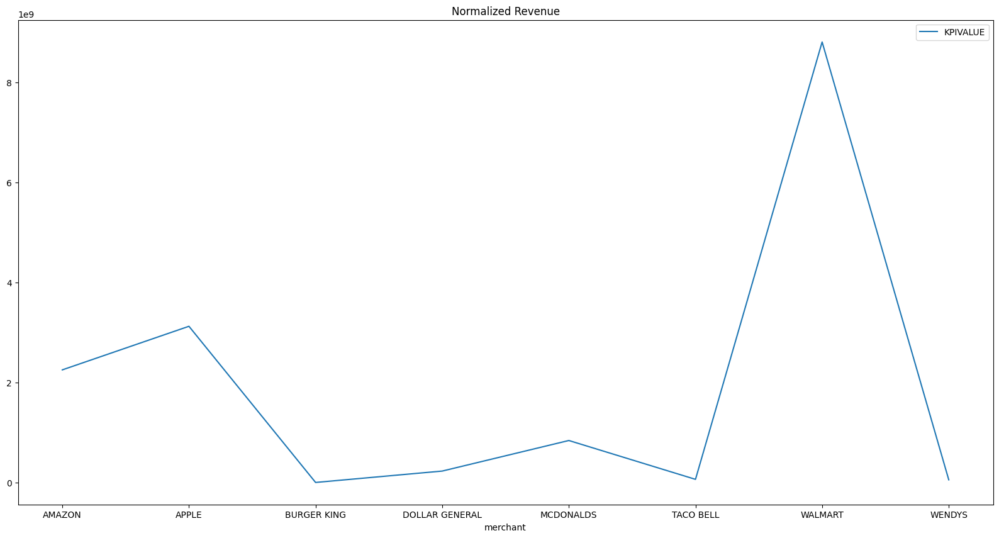

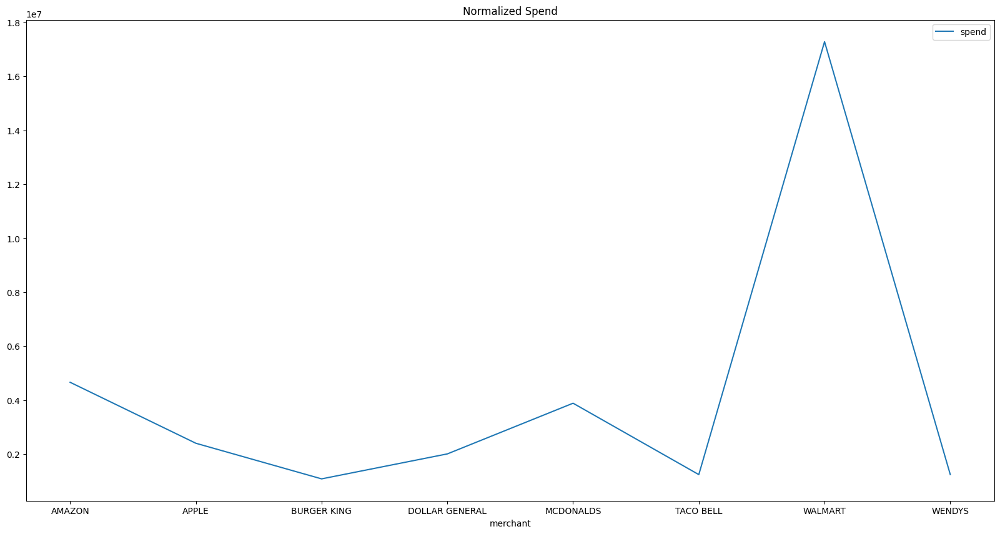

In [110]:
# Plot total spend's and revenues for each company
df_grouped_part5.groupby('merchant')[['KPIVALUE']].sum().plot(figsize=(20,10), title='Normalized Revenue')
df_grouped_part5.groupby('merchant')[['spend']].sum().plot(figsize=(20,10), title='Normalized Spend')

In [111]:
# For each cluster we will have ...
# company, ticker, exchange, account, fiscal_quarter, spend, revenue, cluster_number, cluster_weight
#
# Now, we do the following
# (1) spend*cluster_weight
# (2) predict company's quarter revenue by sum of spend*cluster_weight's associated with the current company and quarter
# (3) show revenue, total spend, MAPE for each company/quarter and total

# Get clusters from HW 2
acnt_date_merc_spend = df[['account', 'date', 'merchant', 'spend']].copy()
acnt_date_merc_spend['date'] = pd.to_datetime(df['date']).dt.date
acnt_date_merc_spend

,account,date,merchant,spend
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,AMAZON,4.72
1,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,DUNKIN DONUTS,7.33
2,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,EXXON MOBIL,10.02
3,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-01-01,PNC BANK,212.44
4,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2018-02-01,AMAZON,44.04
...,...,...,...,...
4242940,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,7-ELEVEN,206.00
4242941,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,AMC THEATRES,13.70
4242942,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,ARBYS,5.20
4242943,a04:512:E61B330AB05882BB6F20F35565F07E64,2018-02-01,BATH & BODY WORKS,67.57


In [112]:
date_spend_matrices = {} # store (# merchants, # accounts) spend data for each month (month start date)
for d in tqdm(acnt_date_merc_spend.date.unique()): # iterate per date (for efficiency vs. account)
    # aggregate total spend per merchant and account
    cur = acnt_date_merc_spend[acnt_date_merc_spend.date == d].drop(columns=['date']).groupby(['merchant', 'account']).sum().unstack()

    # align index and column levels and naming to allow smooth expansion below
    cur.index.name = None
    cur.columns = cur.columns.droplevel(0)
    cur.columns.name = None

    # expand index to cover all merchants and dates
    cur = cur.reindex(index=acnt_date_merc_spend.merchant.unique(), columns=acnt_date_merc_spend.account.unique())
    date_spend_matrices[d] = cur

100%|██████████| 36/36 [00:49<00:00,  1.38s/it]


In [113]:
# Manipulate via numpy to obtain (# accounts, # merchants, # months) matrices
acnt_merc_mos = np.transpose(np.stack(list(date_spend_matrices.values()), axis=0), axes=(2, 1, 0))
acnt_merc_mos.shape # note that the ordering of the accounts, merchants, months are preserved from the original data

(10000, 1390, 36)

In [114]:
acnt_merc_mos[np.isnan(acnt_merc_mos)] = 0.0 # convert nans to zeroes for ease of distance metric calculation

In [115]:
# Using Euclidean distance (equivalently cosine similarity) for computational reasons
X = pd.DataFrame(np.sum(acnt_merc_mos, axis=-2))
X.index = date_spend_matrices[list(date_spend_matrices.keys())[0]].columns
for i in range(X.shape[0]):
    X.iloc[i, :] /= np.linalg.norm(X.iloc[i, :]) # normalize first for stability in fit downstream

In [116]:
from sklearn.cluster import KMeans

# Define the number of clusters
n_clusters = 15

# Fit KMeans with the normalized data
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
kmeans.fit(X)

# Retrieve the cluster assignments and cluster centers
labels = kmeans.labels_
cluster_centers = kmeans.cluster_centers_

In [117]:
clusters = pd.DataFrame(labels, index=X.index).reset_index()
clusters.columns = ['account', 'Cluster']
clusters

,account,Cluster
0,a04:512:000ACA1D00B403C9BD4848010BBBCB63,10
1,a04:512:001102B925FF6841524DE5D8774A81A9,4
2,a04:512:002038B3B84497A0947BAFF4A237C8B1,7
3,a04:512:0022889224C5EB250061414C9B50B69A,9
4,a04:512:00247AEF269FF39090229B01ECF0B8CB,8
...,...,...
9995,a04:512:E5F31DF4D7669E000041D09C689ED1B5,10
9996,a04:512:E607E11C019BC0E50E654D9B271E7816,0
9997,a04:512:E6111FBE3C44A4E767E29915A7B173BB,10
9998,a04:512:E616119E37C9B834DBC35EC600A5D95E,13


Text(0.5, 1.0, 'User Clusters Histogram')

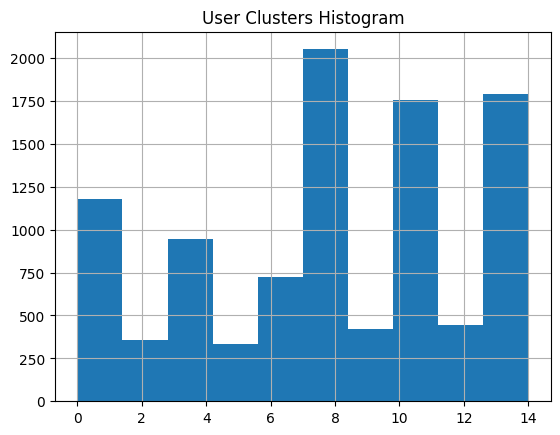

In [118]:
clusters.Cluster.hist()
plt.title('User Clusters Histogram')

In [119]:
df_final = df_grouped_part5.merge(clusters, on='account') # Join cluster info with spend and revenue data above
df_final

,merchant,MERCHANT_TICKER,MERCHANT_EXCHANGE,account,FISCAL_QUARTER,spend,KPINAME,KPIVALUE,Cluster
0,AMAZON,AMZN,NASDAQ,a04:512:000ACA1D00B403C9BD4848010BBBCB63,2017-4Q,4.72,North America Revenue,37302.0,10
1,AMAZON,AMZN,NASDAQ,a04:512:002038B3B84497A0947BAFF4A237C8B1,2017-4Q,153.09,North America Revenue,37302.0,7
2,AMAZON,AMZN,NASDAQ,a04:512:00C237994685905D704F0F4E3349EFF9,2017-4Q,56.72,North America Revenue,37302.0,7
3,AMAZON,AMZN,NASDAQ,a04:512:00C8B9610382909000A3F99574A4859D,2017-4Q,10.74,North America Revenue,37302.0,6
4,AMAZON,AMZN,NASDAQ,a04:512:00D49AE488400D8B9178C77D86B109E2,2017-4Q,11.18,North America Revenue,37302.0,4
...,...,...,...,...,...,...,...,...,...
483704,WALMART,WMT,NYSE,b01:44132:973710379,2021-4Q,316.55,Walmart US Net Sales,99600.0,14
483705,WALMART,WMT,NYSE,b01:44132:974188721,2021-4Q,328.55,Walmart US Net Sales,99600.0,11
483706,WALMART,WMT,NYSE,b01:44132:975096837,2021-4Q,109.27,Walmart US Net Sales,99600.0,11
483707,WALMART,WMT,NYSE,b01:44132:975106352,2021-4Q,264.22,Walmart US Net Sales,99600.0,5


In [120]:
df_final['KPIVALUE'] *= 1e+6

In [121]:
y = df_final.groupby(['MERCHANT_TICKER', 'FISCAL_QUARTER'])['KPIVALUE'].first()
X = df_final.groupby(['MERCHANT_TICKER', 'FISCAL_QUARTER', 'Cluster'])['spend'].sum()

In [122]:
X = X.unstack().fillna(0)
X

Cluster                               0         1        2        3        4   \
MERCHANT_TICKER FISCAL_QUARTER                                                  
AAPL            2018-1Q          3221.55    784.88   493.92  1118.31   701.35   
                2018-2Q         12335.15   4414.95  3189.35  3322.47  2880.92   
                2018-3Q         12544.88   6614.69  3505.48  5180.18  5752.63   
                2018-4Q         13780.77   6185.91  3596.55  6452.36  6071.26   
                2019-1Q         12522.87   7987.45  3253.86  6809.65  5663.23   
...                                  ...       ...      ...      ...      ...   
YUM             2019-4Q          3550.36   6224.06  2105.70  4470.45  3283.43   
                2020-1Q          3523.83  11263.52  3549.37  5659.74  4568.05   
                2020-2Q          3555.36   9211.47  2951.91  5672.43  8282.64   
                2020-3Q          3023.51   6273.54  3059.01  6888.56  4777.64   
                2020-4Q          1378.31   3299.93  1638.73  5604.11  2690.27   

Cluster                              5         6         7         8   \
MERCHANT_TICKER FISCAL_QUARTER                                          
AAPL            2018-1Q          462.67   1252.05   6474.95    982.94   
                2018-2Q         2920.67   4019.95  22155.25   4041.25   
                2018-3Q         3667.02   7182.75  25203.23   9363.45   
                2018-4Q         4463.19   9919.92  27556.38  15138.64   
                2019-1Q         4527.76  12288.86  27953.46  14238.89   
...                                 ...       ...       ...       ...   
YUM             2019-4Q         2457.20  11832.00  17375.69   4446.81   
                2020-1Q         3645.64   9571.48  19970.96   5640.60   
                2020-2Q         4174.83   8166.80  21585.18   4457.67   
                2020-3Q         3288.82   6784.02  18180.86   3708.53   
                2020-4Q         1771.12   3417.53  11354.55   2748.24   

Cluster                              9         10        11       12       13  \
MERCHANT_TICKER FISCAL_QUARTER                                                  
AAPL            2018-1Q          911.51   2955.27   1311.21  1906.54   578.62   
                2018-2Q         3676.65  10807.28   6736.57  7026.14  1999.38   
                2018-3Q         4870.55  13239.70   9122.70  6048.32  4013.77   
                2018-4Q         6099.72  14265.40  13402.06  4290.77  4639.02   
                2019-1Q         6233.89  14306.96  14097.78  5125.15  5794.88   
...                                 ...       ...       ...      ...      ...   
YUM             2019-4Q         2171.78   6616.32  13293.02  3236.99  3573.74   
                2020-1Q         3272.95   6174.97  15105.85  4691.26  4043.40   
                2020-2Q         4784.88   5256.37  15344.43  4750.90  5808.69   
                2020-3Q         3747.36   3684.97  14055.07  3989.49  7138.35   
                2020-4Q         1542.83   2470.66   7402.57  1850.11  3396.24   

Cluster                               14  
MERCHANT_TICKER FISCAL_QUARTER            
AAPL            2018-1Q           785.26  
                2018-2Q          4198.95  
                2018-3Q         16013.97  
                2018-4Q         22503.36  
                2019-1Q         25732.25  
...                                  ...  
YUM             2019-4Q         19076.31  
                2020-1Q         20730.54  
                2020-2Q         23560.49  
                2020-3Q         19683.90  
                2020-4Q         12526.29  

[104 rows x 15 columns]

In [123]:
selected_indices = X.sample(frac=0.2, random_state=42).index

# Split train_test
X_test = X.loc[selected_indices]
X_train = X.drop(selected_indices)
y_test = y.loc[selected_indices]
y_train = y.drop(selected_indices)

In [124]:
# Write the optimization for MAPE
from scipy.optimize import minimize

def obj_func(weights):
    return (np.abs(y_train - X_train@weights)/y_train).mean()*100 # Minimizing MAPE

# Initial weights guess
initial_guess = [7.5]*15

# Define weights' bounds
bounds = [(1, 15)]*15

# Call minimizer
result = minimize(obj_func, initial_guess, method='Nelder-Mead', bounds=bounds)
result.x

array([14.75451113, 13.59820299, 14.65739479, 14.80914382, 13.65427416,
       14.56442643, 14.97321214, 15.        , 14.93985401,  1.        ,
       15.        , 13.87349367,  1.        , 14.98712364, 14.98412213])

In [125]:
result.fun

np.float64(99.93896922257254)

<Axes: title={'center': 'Quarter Spends'}, xlabel='FISCAL_QUARTER'>

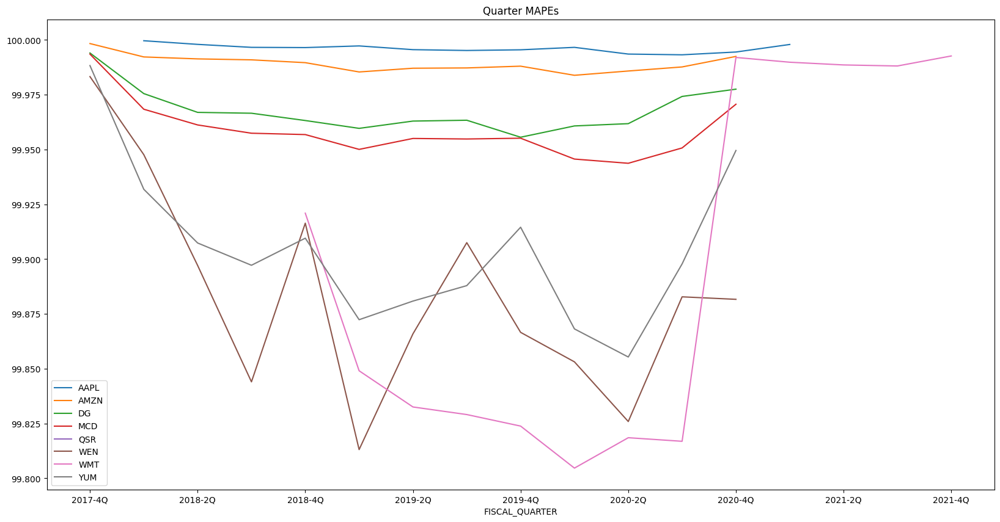

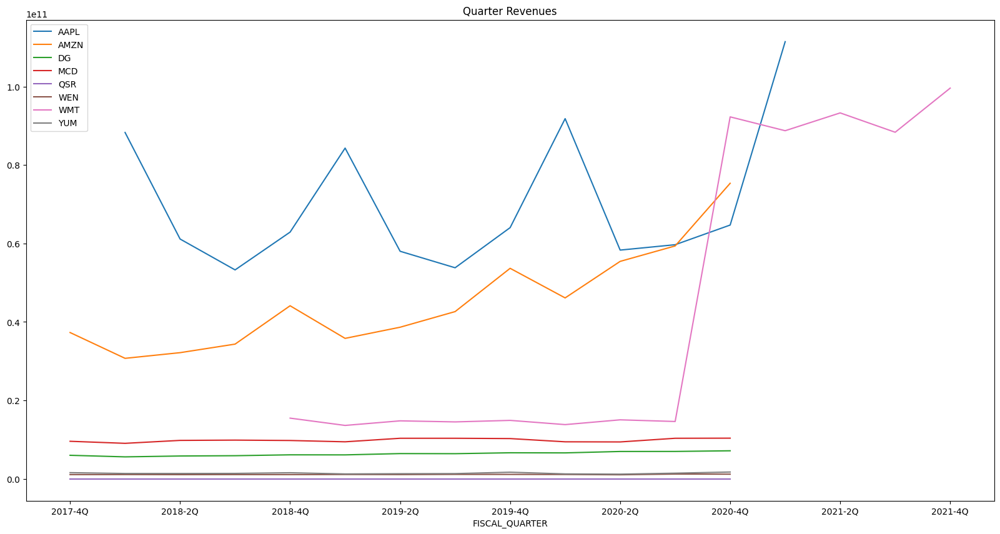

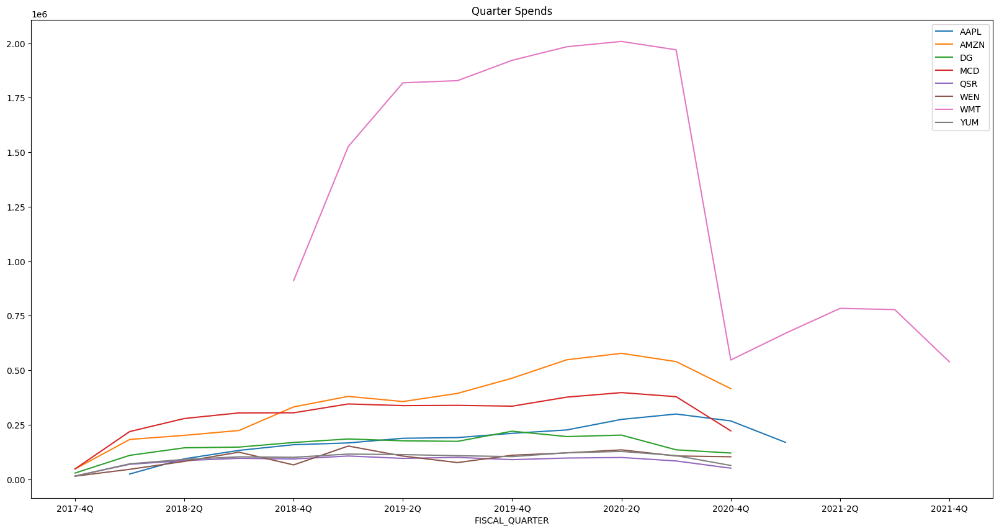

In [126]:
preds = X@result.x

# Plot per company MAPES, revenues, and spends across fiscal quarters
quarter_mapes = {}
quarter_revenues = {}
quarter_spends = {}
for company in y.index.get_level_values('MERCHANT_TICKER'):
    mapes = 100*((y.loc[company] - preds.loc[company]).abs()/y.loc[company]).groupby('FISCAL_QUARTER').mean()
    quarter_mapes[company] = mapes
    quarter_revenues[company] = y.loc[company].groupby('FISCAL_QUARTER').sum()
    quarter_spends[company] = X.loc[company].sum(axis=1)
pd.DataFrame(quarter_mapes).plot(figsize=(20,10), title='Quarter MAPEs')
pd.DataFrame(quarter_revenues).plot(figsize=(20,10), title='Quarter Revenues')
pd.DataFrame(quarter_spends).plot(figsize=(20,10), title='Quarter Spends')

In [127]:
print('Total MAPE:', ((y_train-preds).abs()/y_train).mean()*100)

Total MAPE: 99.93896922257254


In [128]:
print('Test Set MAPE:', 100*((y_test - X_test@result.x)/y_test).mean())

Test Set MAPE: 99.95491241918116
